In [1]:
! python --version

Python 3.11.9


In [2]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
from matplotlib import cm, colors
from matplotlib.lines import Line2D
from matplotlib.collections import PatchCollection
from matplotlib import patches

import seaborn as sns

import scipy.sparse

import geopandas as gpd

import scanpy as sc

import anndata as an
import scanorama

from pathlib import Path

import squidpy as sq

import os
import warnings

from shapely.geometry import Polygon, MultiPolygon, Point
from shapely.affinity import affine_transform

import matplotlib.patches as patches
from matplotlib.collections import PatchCollection
from shapely.geometry import Polygon, MultiPolygon
from scipy.ndimage import rotate

import math

import tifffile

from numpy.linalg import inv
from skimage.transform import AffineTransform, warp

from skimage import exposure

sc.logging.print_versions()

-----
anndata     0.10.7
scanpy      1.10.0
-----
PIL                         10.3.0
annoy                       NA
anyio                       NA
asciitree                   NA
asttokens                   NA
attr                        23.1.0
attrs                       23.1.0
babel                       2.11.0
brotli                      1.0.9
certifi                     2025.01.31
cffi                        1.16.0
charset_normalizer          2.0.4
cloudpickle                 3.0.0
colorama                    0.4.6
comm                        0.2.1
cycler                      0.12.1
cython_runtime              NA
dask                        2024.5.0
dask_expr                   1.1.0
dask_image                  2023.08.1
datashader                  0.16.1
datatree                    0.0.14
dateutil                    2.8.2
debugpy                     1.6.7
decorator                   5.1.1
defusedxml                  0.7.1
docrep                      0.3.2
executing                  

In [5]:
warnings.simplefilter("ignore")

custom_palette = [ "#a70e62", "#e10e3c", "#f47140", "#f0b932", "#ffd95a", "#c2ed51", "#8ed73d", "#489c73", "#1a8d83", 
                  "#4915be", "#2357d5", "#fed2ff", "#6ecad5", "#BD08F9", '#886fc2', "#e170c0", "#FF33CC", "#e4a9e8"]

# Read the list of genes, 200 spike genes subset 
genes_to_include_file =  "GenePanel/file_records/subset_spikegenes_list.txt"

with open(genes_to_include_file, "r") as file:
    genes_to_include = [line.strip() for line in file]

### This notebook documents sample integration with scanorama, leiden clustering with scanpy, and gene enrichment analysis 

Sample information: 

VGN1e1 = late double ridge, VRT-A2a (P1 WT) <p>
VGN1e9 = late double ridge, VRT-A2b (P1 Pol) <p>
VGN1b6 = lemma primorida, VRT-A2a (P1 WT) <p>
VGN1b8 = lemma primorida, VRT-A2b (P1 Pol) <p>
VGN1a6 = terminal spikelet, VRT-A2a (P1 WT) <p>
VGN1a4 = terminal spikelet, VRT-A2b (P1 Pol) <p>
VGN1c2 = carpel extension round, VRT-A2a (P1 WT) <p>
VGN1c3 = carpel extension round, VRT-A2b (P1 Pol)

See this vignette for more details: https://scanpy-tutorials.readthedocs.io/en/latest/spatial/basic-analysis.html


### First I am going to read in my filtered & normalised adata objects for each sample

In [6]:
# Define the filenames of the saved AnnData objects
adata_filenames = {
    "adata_VGN1a6": "qc/adata_VGN1a6_clean.h5ad",
    "adata_VGN1a4": "qc/adata_VGN1a4_clean.h5ad",
    "adata_VGN1b6": "qc/adata_VGN1b6_clean.h5ad",
    "adata_VGN1b8": "qc/adata_VGN1b8_clean.h5ad",
    "adata_VGN1e1": "qc/adata_VGN1e1_clean.h5ad",
    "adata_VGN1e9": "qc/adata_VGN1e9_clean.h5ad",
    "adata_VGN1c2": "qc/adata_VGN1c2_clean.h5ad",
    "adata_VGN1c3": "qc/adata_VGN1c3_clean.h5ad"
}

# Initialize a dictionary to store the loaded AnnData objects
loaded_adata_objects = {}

# Load each file and store it in the dictionary
for name, filename in adata_filenames.items():
    loaded_adata_objects[name] = sc.read_h5ad(filename)
    print(f"Loaded {name} from {filename}")

# Access the loaded AnnData objects
adata_VGN1a6 = loaded_adata_objects["adata_VGN1a6"]
adata_VGN1a4 = loaded_adata_objects["adata_VGN1a4"]

adata_VGN1b6 = loaded_adata_objects["adata_VGN1b6"]
adata_VGN1b8 = loaded_adata_objects["adata_VGN1b8"]


adata_VGN1e1 = loaded_adata_objects["adata_VGN1e1"]
adata_VGN1e9 = loaded_adata_objects["adata_VGN1e9"]


adata_VGN1c2 = loaded_adata_objects["adata_VGN1c2"]
adata_VGN1c3 = loaded_adata_objects["adata_VGN1c3"]

Loaded adata_VGN1a6 from qc/adata_VGN1a6_clean.h5ad
Loaded adata_VGN1a4 from qc/adata_VGN1a4_clean.h5ad
Loaded adata_VGN1b6 from qc/adata_VGN1b6_clean.h5ad
Loaded adata_VGN1b8 from qc/adata_VGN1b8_clean.h5ad
Loaded adata_VGN1e1 from qc/adata_VGN1e1_clean.h5ad
Loaded adata_VGN1e9 from qc/adata_VGN1e9_clean.h5ad
Loaded adata_VGN1c2 from qc/adata_VGN1c2_clean.h5ad
Loaded adata_VGN1c3 from qc/adata_VGN1c3_clean.h5ad


### Now I will look at clustering my data by integrating all the samples together with scanorama and performing leiden clustering

I am following this documentation: 
https://scanpy-tutorials.readthedocs.io/en/latest/spatial/integration-scanorama.html#Data-integration

In [9]:
adata_VGN1a6.obs['dataset'] = 'VGN1a6'
adata_VGN1a4.obs['dataset'] = 'VGN1a4'
adata_VGN1b6.obs['dataset'] = 'VGN1b6'
adata_VGN1b8.obs['dataset'] = 'VGN1b8'
adata_VGN1c2.obs['dataset'] = 'VGN1c2'
adata_VGN1c3.obs['dataset'] = 'VGN1c3'
adata_VGN1e1.obs['dataset'] = 'VGN1e1'
adata_VGN1e9.obs['dataset'] = 'VGN1e9'

adatas = [adata_VGN1a6, adata_VGN1a4, adata_VGN1b6, adata_VGN1b8, adata_VGN1c2, adata_VGN1c3, adata_VGN1e1, adata_VGN1e9]
keys = ['VGN1a6', 'VGN1a4', 'VGN1b6', 'VGN1b8', 'VGN1c2', 'VGN1c3', 'VGN1e1', 'VGN1e9'] 
# Add unique labels for concatenation

#create new AnnData objects and replace adata.X with the Scanorama-transformed cell-by-gene matrix, while keeping the other metadata in adata as well.
#The adata.X (expression score) will be corrected and scaled so that we can look between different samples and concatenate them into one. 
adatas_cor = scanorama.correct_scanpy(adatas, return_dimred=True)

# Concatenate corrected datasets
adata_spatial = sc.concat(
    adatas_cor,
    label="dataset",  # Use the 'dataset' column as label
    uns_merge="unique",
    keys=keys,
    index_unique="-",
)
# perform UMAP clustering of the concatenated samples
sc.pp.neighbors(adata_spatial, use_rep="X_scanorama")
sc.tl.umap(adata_spatial)

sc.tl.leiden(adata_spatial, resolution = 1, key_added="clusters", directed=False)

Found 200 genes among all datasets
[[0.         0.74560592 0.62879834 0.53725676 0.55078631 0.41609621
  0.36939792 0.36073932]
 [0.         0.         0.59564917 0.51637399 0.6898982  0.57102584
  0.19963785 0.18546845]
 [0.         0.         0.         0.65685809 0.4371547  0.2406768
  0.45359891 0.30592734]
 [0.         0.         0.         0.         0.4717608  0.37399146
  0.34314169 0.3486297 ]
 [0.         0.         0.         0.         0.         0.83118531
  0.33001358 0.27597196]
 [0.         0.         0.         0.         0.         0.
  0.51923947 0.46462715]
 [0.         0.         0.         0.         0.         0.
  0.         0.84384959]
 [0.         0.         0.         0.         0.         0.
  0.         0.        ]]
Processing datasets (6, 7)
Processing datasets (4, 5)
Processing datasets (0, 1)
Processing datasets (1, 4)
Processing datasets (2, 3)
Processing datasets (0, 2)
Processing datasets (1, 2)
Processing datasets (1, 5)
Processing datasets (0, 4)
Pr

## visualising UMAP of clusters 

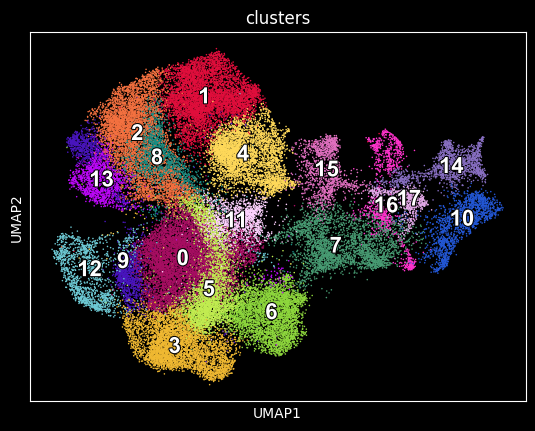

In [52]:
import matplotlib.pyplot as plt
import matplotlib.patheffects as pe
import scanpy as sc

plt.style.use('dark_background')

# Create plot
sc.pl.umap(
    adata_spatial,
    color="clusters",
    palette=custom_palette,
    show=False,
    legend_loc="on data",
    legend_fontsize=16,
    legend_fontoutline=1,
    size=5
)

# Customize font style
ax = plt.gca()
for text in ax.texts:
    # Change font family and weight
    text.set_fontfamily('arial')     # options: 'serif', 'sans-serif', 'monospace', etc.
    text.set_fontweight('bold')      # options: 'normal', 'bold', etc.
    text.set_fontstyle('normal')     # optional: 'normal', 'italic', 'oblique'
    
    # Optional: change outline color to black
    text.set_path_effects([pe.withStroke(linewidth=1.5, foreground='black')])

# Save figure
plt.savefig("leidenclustering/figures/UMAP_VRT_A2a_A2b_200genes_res1.png", dpi=600, bbox_inches='tight', format='png', transparent=True)


### Saving cluster information into hdf5 file 

In [ ]:
#this file contains the same information in the index, I will use this for analysis 
file_path = "leidenclustering/VRT_A2a_A2b_leiden_200genes_res1_indexed.h5ad"
adata_spatial.write_h5ad(file_path)

#When I am importing .hdf5 files to the VizGen visualiser I need to remove all of the sample information included in the index
# Rename the index column to only include the numbers before the '-' character
adata_indexing = adata_spatial.copy()
adata_indexing.obs.index = [index.split('-')[0] for index in adata_indexing.obs.index]

# Assuming your AnnData object is named 'adata'
file_path = "leidenclustering/VRT_A2a_A2b_leiden_200genes_res1.hdf5"
# Save the AnnData object as an HDF5 file
adata_indexing.write_h5ad(file_path)


## Creating a table with each cell and their domain assignment 
</p>
Supplemental Table 9:
Cell ID, domain assignment, sample id

In [12]:
cluster_info = adata_spatial.obs['clusters'].copy()
cluster_assignment_df = cluster_info.reset_index()
cluster_assignment_df[['cell_id', 'sample']] = cluster_assignment_df['index'].str.split('-', expand=True)
cluster_assignment_df.drop(columns=['index'], inplace=True)

cluster_assignment_df.to_csv("leidenclustering/DomainAssignment_PerCell.csv", index=False)
cluster_assignment_df

,clusters,cell_id,sample
0,0,2305551000002100247,VGN1a6
1,3,2305551000002100249,VGN1a6
2,9,2305551000002100250,VGN1a6
3,3,2305551000002100262,VGN1a6
4,6,2305551000002100268,VGN1a6
...,...,...,...
50726,4,2655507000138100169,VGN1e9
50727,4,2655507000138100170,VGN1e9
50728,0,2655507000138100176,VGN1e9
50729,4,2655507000138100177,VGN1e9


### how many clusters make up each sample? what clusters are unique to timepoints TS and CER? 

In [57]:
cluster_info = adata_spatial.obs['clusters'].copy()
df = cluster_info.reset_index()
df[['cell_id', 'sample']] = df['index'].str.split('-', expand=True)
df.drop(columns=['index'], inplace=True)
cluster_sample_counts = df.groupby(['clusters', 'sample']).size().reset_index(name='cell_count')

sample_order = ['VGN1e1', 'VGN1e9', 'VGN1b6','VGN1b8', 'VGN1a6', 'VGN1a4', 'VGN1c2', 'VGN1c3'] 

# Filter the DataFrame to include only the specified samples
cluster_sample_counts_filtered = cluster_sample_counts[cluster_sample_counts['sample'].isin(sample_order)]

# Set the 'sample' column as a categorical type with the specified order
cluster_sample_counts_filtered['sample'] = pd.Categorical(cluster_sample_counts_filtered['sample'], categories=sample_order, ordered=True)

# Sort the DataFrame by the 'sample' column based on the categorical order
cluster_sample_counts_ordered = cluster_sample_counts_filtered.sort_values('sample')

# Calculate the total number of cells per sample
total_cells_per_sample = cluster_sample_counts_ordered.groupby('sample')['cell_count'].sum().reset_index(name='total_cells')

# Merge the total cells with the original filtered DataFrame
cluster_sample_counts_w_total = pd.merge(cluster_sample_counts_ordered, total_cells_per_sample, on='sample')

# Calculate the percentage of cells per cluster in each sample
cluster_sample_counts_w_total['percentage'] = (cluster_sample_counts_w_total['cell_count'] / cluster_sample_counts_w_total['total_cells']) * 100

# Step 1: Filter rows with 'percentage' > 1
filtered_df = cluster_sample_counts_w_total[cluster_sample_counts_w_total['percentage'] > 0.5]

# Step 2: Tally number of clusters per 'sample'
clusters_per_sample = filtered_df.groupby('sample')['clusters'].nunique()
print("Number of clusters per sample (percentage > 0.5):")
print(clusters_per_sample)

# Step 3: Identify clusters in VGN1a6, VGN1a4, VGN1c2, VGN1c3 that are not in the other samples
target_samples = ['VGN1a6', 'VGN1a4', 'VGN1c2', 'VGN1c3']

# Clusters in target samples
clusters_in_target = set(filtered_df[filtered_df['sample'].isin(target_samples)]['clusters'])

# Clusters in other samples
clusters_in_other = set(filtered_df[~filtered_df['sample'].isin(target_samples)]['clusters'])

# Clusters unique to target samples
unique_clusters = clusters_in_target - clusters_in_other

print("\nClusters present only in target samples (not in other samples):")
print(unique_clusters)

Number of clusters per sample (percentage > 0.5):
sample
VGN1e1    11
VGN1e9    10
VGN1b6    12
VGN1b8    12
VGN1a6    17
VGN1a4    17
VGN1c2    18
VGN1c3    17
Name: clusters, dtype: int64

Clusters present only in target samples (not in other samples):
{'16', '14', '7', '17', '15', '10'}


# Gene enrichment analysis 

Logistic Regression
Description: This method models the probability of a gene being expressed in one cluster versus others
A higher score means that the gene is more likely to be associated with the cluster in question. Conversely, lower or negative scores suggest that the gene is less expressed in that cluster relative to others.

See publication: A discriminative learning approach to differential expression analysis for single-cell RNA-seq

In [57]:
sc.tl.rank_genes_groups(adata_spatial, groupby='clusters', method='logreg')

In [59]:
# Inspect the keys in the rank_genes_groups result
result = adata_spatial.uns['rank_genes_groups']
print(result.keys())

dict_keys(['params', 'names', 'scores'])


### i want these values exported as a dataframe containing Gene, LogReg Score, and normalised counts (by sample) 


In [51]:
#loading my adata objects again 
adata_filenames = {
    "adata_VGN1a6": "qc/adata_VGN1a6_clean.h5ad",
    "adata_VGN1a4": "qc/adata_VGN1a4_clean.h5ad",
    "adata_VGN1b6": "qc/adata_VGN1b6_clean.h5ad",
    "adata_VGN1b8": "qc/adata_VGN1b8_clean.h5ad",
    "adata_VGN1e1": "qc/adata_VGN1e1_clean.h5ad",
    "adata_VGN1e9": "qc/adata_VGN1e9_clean.h5ad",
    "adata_VGN1c2": "qc/adata_VGN1c2_clean.h5ad",
    "adata_VGN1c3": "qc/adata_VGN1c3_clean.h5ad"
}

# Initialize a dictionary to store the loaded AnnData objects
loaded_adata_objects = {}

# Load each file and store it in the dictionary
for name, filename in adata_filenames.items():
    loaded_adata_objects[name] = sc.read_h5ad(filename)
    print(f"Loaded {name} from {filename}")

# Access the loaded AnnData objects
adata_VGN1a6 = loaded_adata_objects["adata_VGN1a6"]
adata_VGN1a4 = loaded_adata_objects["adata_VGN1a4"]

adata_VGN1b6 = loaded_adata_objects["adata_VGN1b6"]
adata_VGN1b8 = loaded_adata_objects["adata_VGN1b8"]


adata_VGN1e1 = loaded_adata_objects["adata_VGN1e1"]
adata_VGN1e9 = loaded_adata_objects["adata_VGN1e9"]


adata_VGN1c2 = loaded_adata_objects["adata_VGN1c2"]
adata_VGN1c3 = loaded_adata_objects["adata_VGN1c3"]

Loaded adata_VGN1a6 from qc/adata_VGN1a6_clean.h5ad
Loaded adata_VGN1a4 from qc/adata_VGN1a4_clean.h5ad
Loaded adata_VGN1b6 from qc/adata_VGN1b6_clean.h5ad
Loaded adata_VGN1b8 from qc/adata_VGN1b8_clean.h5ad
Loaded adata_VGN1e1 from qc/adata_VGN1e1_clean.h5ad
Loaded adata_VGN1e9 from qc/adata_VGN1e9_clean.h5ad
Loaded adata_VGN1c2 from qc/adata_VGN1c2_clean.h5ad
Loaded adata_VGN1c3 from qc/adata_VGN1c3_clean.h5ad


In [61]:
# List of adata objects and their corresponding output file paths
adatas = [
    (adata_VGN1a6, "VGN1a6"),
    (adata_VGN1a4, "VGN1a4"),
    (adata_VGN1b6, "VGN1b6"),
    (adata_VGN1b8, "VGN1b8"),
    (adata_VGN1c2, "VGN1c2"),
    (adata_VGN1c3, "VGN1c3"),
    (adata_VGN1e1, "VGN1e1"),
    (adata_VGN1e9, "VGN1e9")
]

# making a dataframe with cluster assignments
clusters_df = pd.DataFrame(adata_spatial.obs['clusters'])
clusters_df.index = clusters_df.index.str.split('-').str[0]

# Dictionary to store DataFrames
dataframes = {}

# extracting normalised expression counts
def process_adata(adata, clusters_df, df_name):
    # Convert sparse matrix to dense if necessary
    if isinstance(adata.X, scipy.sparse.spmatrix):
        X_dense = adata.X.toarray()
    else:
        X_dense = adata.X
    
    # Create gene expression matrix dataframe
    cell_names = adata.obs_names
    gene_names = adata.var_names
    gene_expression_matrix = pd.DataFrame(data=X_dense, index=cell_names, columns=gene_names)
    
    # Merge df_clusters with df_counts on index (cell ID)
    merged_df = pd.merge(gene_expression_matrix, clusters_df, left_index=True, right_index=True)
    
    # Group by clusters and calculate the average counts for each transcript ID
    cluster_counts = merged_df.groupby('clusters').mean()
    cluster_counts = cluster_counts.transpose()
    
    # Replace columns with NaN in cases of few cells (very low represented cell groups) 
    if df_name in ['VGN1e1', 'VGN1e9']:
        cluster_counts.loc[:, ['7', '5', '15', '8']] = np.nan
    elif df_name in ['VGN1b6', 'VGN1b8']:
        cluster_counts.loc[:, ['7', '15']] = np.nan
    elif df_name in ['VGN1a4', 'VGN1a6']:
        cluster_counts.loc[:, ['17']] = np.nan
    
    # Store the DataFrame in the dictionary
    dataframes[df_name] = cluster_counts

# Process each adata object and store the results in dataframes dictionary
for adata, df_name in adatas:
    process_adata(adata, clusters_df, df_name)

# Access the DataFrames using the keys
VGN1a6 = dataframes['VGN1a6']
VGN1a4 = dataframes['VGN1a4']
VGN1b6 = dataframes['VGN1b6']
VGN1b8 = dataframes['VGN1b8']
VGN1c2 = dataframes['VGN1c2']
VGN1c3 = dataframes['VGN1c3']
VGN1e1 = dataframes['VGN1e1']
VGN1e9 = dataframes['VGN1e9']

In [62]:
# save results of rank gene groups
result = adata_spatial.uns['rank_genes_groups']

# Get the cluster names
cluster_names = result['names'].dtype.names

# Initialize lists to store data
genes = []
scores = []
clusters = []

# Iterate over each cluster to populate lists
for cluster in cluster_names:
    cluster_genes = result['names'][cluster]  # Get gene names for the cluster
    cluster_scores = result['scores'][cluster]  # Get scores for the cluster
    
    # Append each gene and its corresponding score to the lists
    for gene, score in zip(cluster_genes, cluster_scores):
        genes.append(gene)
        scores.append(score)
        clusters.append(cluster)  # Add the cluster name

# Create a DataFrame
markergene_df = pd.DataFrame({
    'gene': genes,
    'score': scores,
    'cluster': clusters
})


# Restructure the dataframe using pivot
restructured_df = markergene_df.pivot(
    index='gene',       # Use 'gene' as the index
    columns='cluster',  # Use 'cluster' to create new columns
    values='score'      # Populate the new columns with 'score' values
)

# Rename columns to include '_EnrichmentScore' suffix
restructured_df.columns = [f"{cluster}_EnrichmentScore" for cluster in restructured_df.columns]

# Reset index to make 'gene' a regular column
restructured_df.reset_index(inplace=True)

# Sort enrichment score columns numerically
enrichment_cols = sorted(
    [col for col in restructured_df.columns if '_EnrichmentScore' in col],  # Filter for enrichment score columns
    key=lambda x: int(x.split('_')[0])  # Extract numeric part and sort
)

# Reorder the dataframe columns
restructured_df = restructured_df[['gene'] + enrichment_cols]

# Ensure 'gene' is the index in the restructured dataframe for alignment
restructured_df.set_index('gene', inplace=True)

# Initialize the base dataframe with enrichment scores
enrichmentscore_normexp_combined_df = restructured_df.copy()

# Iterate over the sample-specific dataframes in the dictionary
for sample, sample_df in dataframes.items():
    # Reset index to bring 'gene' into a column
    sample_df = sample_df.reset_index()

    # Align the sample dataframe with the restructured dataframe on 'gene'
    sample_df = sample_df.set_index('index')  # Use 'index' (former gene names) as the new index
    sample_df = sample_df.rename_axis('gene')  # Rename the index to 'gene'

    # Add sample-specific prefixes to columns
    sample_df = sample_df.rename(columns=lambda col: f"{sample}_{col}")

    # Merge the sample data with the combined dataframe
    enrichmentscore_normexp_combined_df = enrichmentscore_normexp_combined_df.join(sample_df, how='left')

# Reset the index to make 'gene' a regular column
enrichmentscore_normexp_combined_df.reset_index(inplace=True)

# Desired sample order
sample_order = ['VGN1e1', 'VGN1e9', 'VGN1b6', 'VGN1b8', 'VGN1a6', 'VGN1a4', 'VGN1c2', 'VGN1c3']

# Get the list of expression columns to order
expression_columns = [col for col in enrichmentscore_normexp_combined_df.columns if any(sample in col for sample in sample_order)]

# Sort the expression columns by the desired sample order
ordered_expression_columns = sorted(expression_columns, key=lambda col: sample_order.index(col.split('_')[0]))

# Keep non-expression columns (e.g., 'gene', enrichment scores) in the beginning
non_expression_columns = [col for col in enrichmentscore_normexp_combined_df.columns if col not in expression_columns]

# Reorder the dataframe columns
enrichmentscore_normexp_combined_df = enrichmentscore_normexp_combined_df[non_expression_columns + ordered_expression_columns]

In [59]:
enrichmentscore_normexp_combined_df2 = enrichmentscore_normexp_combined_df.copy()

# Define the mapping of replacements
replacement_map = {
    'VGN1e1': 'LDR_WT_cluster',
    'VGN1e9': 'LDR_VRT-A2b_cluster',
    'VGN1b6': 'LP_WT_cluster',
    'VGN1b8': 'LP_VRT-A2b_cluster',
    'VGN1a6': 'TS_WT_cluster',
    'VGN1a4': 'TS_VRT-A2b_cluster',
    'VGN1c2': 'CER_WT_cluster',
    'VGN1c3': 'CER_VRT-A2b_cluster'
}

# Rename columns using the mapping
def rename_columns(col_name):
    for old_value, new_value in replacement_map.items():
        if col_name.startswith(old_value):
            return col_name.replace(old_value, new_value)
    return col_name

enrichmentscore_normexp_combined_df2.rename(columns=rename_columns, inplace=True)

enrichmentscore_normexp_combined_df2

enrichmentscore_normexp_combined_df2.to_csv("enrichmentanalysis/LogRegScore_NormExpAvg_allsamples.csv", index=False)

,gene,0_EnrichmentScore,1_EnrichmentScore,2_EnrichmentScore,3_EnrichmentScore,4_EnrichmentScore,5_EnrichmentScore,6_EnrichmentScore,7_EnrichmentScore,8_EnrichmentScore,...,CER_VRT-A2b_cluster_8,CER_VRT-A2b_cluster_9,CER_VRT-A2b_cluster_10,CER_VRT-A2b_cluster_11,CER_VRT-A2b_cluster_12,CER_VRT-A2b_cluster_13,CER_VRT-A2b_cluster_14,CER_VRT-A2b_cluster_15,CER_VRT-A2b_cluster_16,CER_VRT-A2b_cluster_17
0,TraesCS1A02G052000,-1.899248,-0.265776,-1.618058,-0.018310,0.812011,-1.089552,-0.354154,-1.914170,-0.421712,...,0.016740,0.027439,0.045747,0.047847,0.017383,0.021586,0.353534,0.229726,0.063127,0.372287
1,TraesCS1A02G077800,-3.895693,-0.690553,-2.864961,-1.759157,-0.803881,-1.694246,5.860512,3.174781,-1.542214,...,0.141597,0.403543,0.189756,0.024777,0.149514,0.996244,0.011831,0.059267,0.131254,0.064863
2,TraesCS1A02G154900,-0.840187,-0.257462,-0.157702,2.576114,0.632968,-0.774375,-0.272984,-0.132877,-0.479977,...,0.005315,0.051778,0.005273,0.015205,0.055854,0.017627,0.015629,0.004341,0.013033,0.009766
3,TraesCS1A02G156100,-2.038370,-0.190227,-0.412845,-0.868299,0.177898,1.730197,0.238617,0.860592,-0.565050,...,0.058267,0.040335,0.102397,0.302900,0.172868,0.087936,0.159085,0.060469,0.041710,0.053610
4,TraesCS1A02G199600,2.371270,-0.677488,2.211071,-2.370305,-1.328793,1.440920,-0.629660,0.245045,-0.228128,...,0.090973,0.028937,0.025283,0.181941,0.220940,0.138797,0.030069,0.029664,0.031233,0.050177
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,TraesCS7D02G342300,-1.323906,-0.532578,-1.139863,-0.538103,3.260145,-1.136548,-0.870831,0.567301,-0.666863,...,0.009702,0.002303,0.090308,0.229741,0.000000,0.010370,0.180497,0.195012,0.085941,0.124137
196,TraesCS7D02G379200,-0.698107,-0.069254,-0.706524,-0.848616,-0.062484,2.485972,-0.639519,-0.449304,0.007441,...,0.026119,0.011584,0.051343,0.189548,0.000000,0.023589,0.042417,0.010876,0.043627,0.009813
197,TraesCS7D02G388600,-0.359088,0.125317,-0.269723,1.336437,0.737247,-0.095077,-0.761950,-0.204690,0.696411,...,0.084736,0.091440,0.049619,0.095866,0.133632,0.061324,0.048247,0.062308,0.032471,0.053517
198,TraesCS7D02G521200,0.681640,-0.897675,-1.102229,-0.981968,-1.312759,-0.640440,2.357756,0.062453,0.057815,...,0.032484,0.015165,0.095812,0.096225,0.020511,0.034811,0.162881,0.227820,0.138573,0.389201


## Now I want to select the top marker genes for each cluster and put these in a table
First I need to select what the 'cut off' is for enriched genes so I will look at the distribution 

Then I will determine a point at which I consider the gene enriched with a +2 STD cut off point 

Mean: 0.0, Standard Deviation: 1.8383444547653198
Cutoff for significantly enriched scores: 3.6766889095306396
                    gene      score cluster
0     TraesCS4A02G256700   9.094888       0
1     TraesCS4B02G064000   6.216168       0
2     TraesCS3D02G284200   4.588726       0
200   TraesCS4D02G296400  13.337225       1
201   TraesCS6D02G220400   8.891061       1
...                  ...        ...     ...
3403  TraesCS7D02G261600   6.040273      17
3404  TraesCS1A02G264300   5.881382      17
3405  TraesCS6D02G220400   4.888692      17
3406  TraesCS2B02G464200   3.843694      17
3407  TraesCS1A02G052000   3.788102      17

[114 rows x 3 columns]


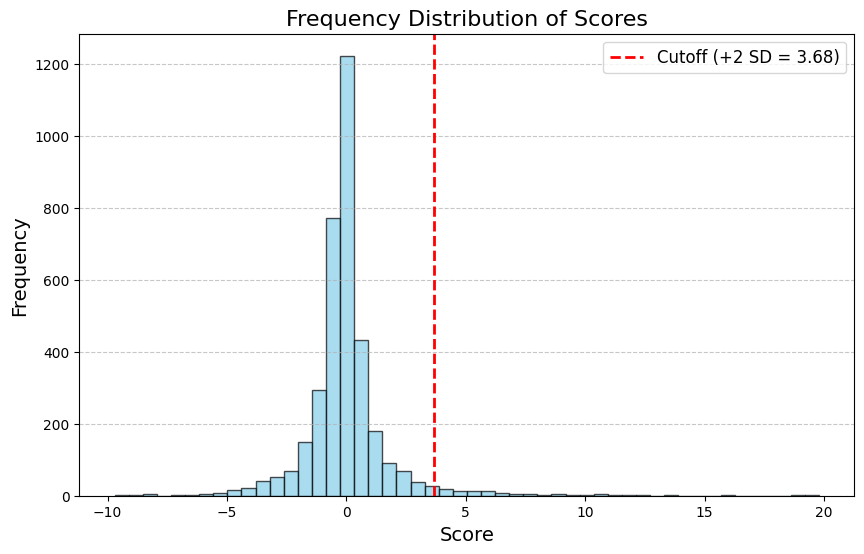

In [63]:
# Calculate mean and standard deviation of the 'score' column
mean_score = markergene_df['score'].mean()
std_score = markergene_df['score'].std()

# Calculate the +2 SD cutoff
cutoff = mean_score + 2 * std_score

print(f"Mean: {mean_score}, Standard Deviation: {std_score}")
print(f"Cutoff for significantly enriched scores: {cutoff}")

# Filter the DataFrame for significant scores
significant_scores_df = markergene_df[markergene_df['score'] > cutoff]

# Display significant scores
print(significant_scores_df)

plt.figure(figsize=(10, 6))
plt.hist(markergene_df['score'], bins=50, color='skyblue', edgecolor='black', alpha=0.7)
plt.axvline(cutoff, color='red', linestyle='--', linewidth=2, label=f'Cutoff (+2 SD = {cutoff:.2f})')
plt.title('Frequency Distribution of Scores', fontsize=16)
plt.xlabel('Score', fontsize=14)
plt.ylabel('Frequency', fontsize=14)
plt.legend(fontsize=12)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()



So for all clusters, the +2 STD cut off is 3.68. 
I will calculate this for each cluster individually to see if this is very variable by cluster. 

In [64]:
# Group the dataframe by 'cluster' and process each group
cluster_results = {}  # To store results for each cluster

for cluster, group in markergene_df.groupby('cluster'):
    # Calculate mean and standard deviation for the current cluster
    mean_score = group['score'].mean()
    std_score = group['score'].std()
    
    # Calculate the +2 SD cutoff
    cutoff = mean_score + 2 * std_score
    
    # Filter significant scores for the current cluster
    significant_scores = group[group['score'] > cutoff]
    
    # Store results
    cluster_results[cluster] = {
        'mean': mean_score,
        'std': std_score,
        'cutoff': cutoff,
        'significant_scores': significant_scores
    }
    
    # Print summary for this cluster
    print(f"Cluster: {cluster}")
    print(f"  Mean: {mean_score:.2f}")
    print(f"  Standard Deviation: {std_score:.2f}")
    print(f"  Cutoff (+2 SD): {cutoff:.2f}")
    print(f"  Significant Scores Count: {len(significant_scores)}")
    print()

# Combine all significant scores into a single DataFrame (optional)
all_significant_scores = pd.concat([res['significant_scores'] for res in cluster_results.values()])


Cluster: 0
  Mean: -0.32
  Standard Deviation: 1.92
  Cutoff (+2 SD): 3.51
  Significant Scores Count: 3

Cluster: 1
  Mean: -0.11
  Standard Deviation: 2.04
  Cutoff (+2 SD): 3.98
  Significant Scores Count: 6

Cluster: 10
  Mean: 0.03
  Standard Deviation: 1.54
  Cutoff (+2 SD): 3.12
  Significant Scores Count: 9

Cluster: 11
  Mean: -0.13
  Standard Deviation: 1.80
  Cutoff (+2 SD): 3.46
  Significant Scores Count: 5

Cluster: 12
  Mean: 0.12
  Standard Deviation: 1.92
  Cutoff (+2 SD): 3.96
  Significant Scores Count: 6

Cluster: 13
  Mean: 0.14
  Standard Deviation: 1.71
  Cutoff (+2 SD): 3.55
  Significant Scores Count: 6

Cluster: 14
  Mean: 0.08
  Standard Deviation: 1.56
  Cutoff (+2 SD): 3.20
  Significant Scores Count: 10

Cluster: 15
  Mean: 0.11
  Standard Deviation: 1.92
  Cutoff (+2 SD): 3.96
  Significant Scores Count: 6

Cluster: 16
  Mean: 0.20
  Standard Deviation: 1.76
  Cutoff (+2 SD): 3.72
  Significant Scores Count: 7

Cluster: 17
  Mean: 0.11
  Standard Deviatio

The scores are not very variable, they vary from 3.12-4.07
But I will apply these for each for the clusters to get my 'top genes' and see how many markers for each this gives me 

In [65]:
# Create an empty list to collect filtered data for each cluster
filtered_data = []

# Dictionary to store row counts for each cluster
cluster_row_counts = {}

# Loop through each cluster group
for cluster, group in markergene_df.groupby('cluster'):
    # Calculate mean and standard deviation for the current cluster
    mean_score = group['score'].mean()
    std_score = group['score'].std()
    
    # Calculate the +2 SD cutoff
    cutoff = mean_score + 2 * std_score
    
    # Filter the group for scores above the cutoff
    filtered_group = group[group['score'] > cutoff]
    
    # Append the filtered group to the list
    filtered_data.append(filtered_group)
    
    # Store the number of rows in the filtered group
    cluster_row_counts[cluster] = len(filtered_group)

# Combine all filtered groups into a single DataFrame
filtered_markergene_df = pd.concat(filtered_data)

# Reset index for clarity (optional)
filtered_markergene_df.reset_index(drop=True, inplace=True)

# Print the row counts for each cluster
print("Number of rows per cluster in the filtered DataFrame:")
for cluster, count in cluster_row_counts.items():
    print(f"Cluster {cluster}: {count} genes")

# Display the filtered DataFrame (optional)
print(filtered_markergene_df)



#how many unique enriched genes are there? 
unique_genes_markers = filtered_markergene_df["gene"].drop_duplicates()

# Display the total number of rows in the filtered DataFrame
print(f"\nTotal unique marker genes: {len(unique_genes_markers)}")


#how many enriched genes appear in one category? multiple categories? 
# Group by gene and count how many unique clusters each gene appears in
gene_cluster_counts = filtered_markergene_df.groupby('gene')['cluster'].nunique()

# Count how many genes appear in only one cluster
single_cluster_genes = (gene_cluster_counts == 1).sum()

# Count how many genes appear in more than one cluster
multi_cluster_genes = (gene_cluster_counts > 1).sum()

# Count how many genes appear in more than two cluster
multi_cluster_genes_two = (gene_cluster_counts > 2).sum()

# Count how many genes appear in more than two cluster
multi_cluster_genes_three = (gene_cluster_counts > 3).sum()

# Print results
print(f"Genes in only one cluster: {single_cluster_genes}")
print(f"Genes in more than one cluster: {multi_cluster_genes}")
print(f"Genes in more than two cluster: {multi_cluster_genes_two}")
print(f"Genes in more than three cluster: {multi_cluster_genes_three}")

Number of rows per cluster in the filtered DataFrame:
Cluster 0: 3 genes
Cluster 1: 6 genes
Cluster 10: 9 genes
Cluster 11: 5 genes
Cluster 12: 6 genes
Cluster 13: 6 genes
Cluster 14: 10 genes
Cluster 15: 6 genes
Cluster 16: 7 genes
Cluster 17: 10 genes
Cluster 2: 5 genes
Cluster 3: 8 genes
Cluster 4: 7 genes
Cluster 5: 4 genes
Cluster 6: 8 genes
Cluster 7: 5 genes
Cluster 8: 3 genes
Cluster 9: 8 genes
                   gene      score cluster
0    TraesCS4A02G256700   9.094888       0
1    TraesCS4B02G064000   6.216168       0
2    TraesCS3D02G284200   4.588726       0
3    TraesCS4D02G296400  13.337225       1
4    TraesCS6D02G220400   8.891061       1
..                  ...        ...     ...
111  TraesCS7B02G413900   5.830931       9
112  TraesCS7A02G175200   4.953066       9
113  TraesCS5A02G356100   4.799537       9
114  TraesCS2B02G399800   4.534127       9
115  TraesCS5A02G473800   3.859297       9

[116 rows x 3 columns]

Total unique marker genes: 54
Genes in only one clust

### Now I want to annotate these markers with their names 

This will be used for Supplementary Table H, with added annotations applied by hand (including literature and label name) 

In [66]:
annotation = pd.read_csv('annotated_names_12_24.csv').dropna()
annotation = annotation.rename(columns={'gene_id': 'gene'})

annotation_subset = annotation[['gene', 'annotated_name']]

# Merge filtered_markergene_df with the annotation_subset on the 'gene' column
filtered_markergene_df_annotated = filtered_markergene_df.merge(annotation_subset, on='gene', how = 'left')

filtered_markergene_df_annotated['annotated_name'] = filtered_markergene_df_annotated['annotated_name'].fillna('')

filtered_markergene_df_annotated

,gene,score,cluster,annotated_name
0,TraesCS4A02G256700,9.094888,0,TraesCS4A02G256700_TaKNOX5
1,TraesCS4B02G064000,6.216168,0,TraesCS4B02G064000_OsGIF3
2,TraesCS3D02G284200,4.588726,0,TraesCS3D02G284200_OsMADS32
3,TraesCS4D02G296400,13.337225,1,TraesCS4D02G296400
4,TraesCS6D02G220400,8.891061,1,TraesCS6D02G220400_TaYABBY7D
...,...,...,...,...
111,TraesCS7B02G413900,5.830931,9,TraesCS7B02G413900_HvMND1
112,TraesCS7A02G175200,4.953066,9,TraesCS7A02G175200_VRT2_OsMADS55
113,TraesCS5A02G356100,4.799537,9,TraesCS5A02G356100_OsIDD6
114,TraesCS2B02G399800,4.534127,9,TraesCS2B02G399800_OsG1L4


### what are the gene names and id of the genes represented in more than 3 clusters? 

In [67]:
top_genes = gene_cluster_counts.sort_values(ascending=False).head(10)
top_genes_df = top_genes.reset_index()
top_genes_df.columns = ['gene', 'total_clusters_enriched']

# Step 2: Perform a left merge with annotated_subset
merged_df = pd.merge(top_genes_df, annotation_subset, on='gene', how='left')

merged_df


,gene,total_clusters_enriched,annotated_name
0,TraesCS6D02G220400,6,TraesCS6D02G220400_TaYABBY7D
1,TraesCS4D02G296400,4,TraesCS4D02G296400
2,TraesCS1D02G197300,4,TraesCS1D02G197300_OsROC3t
3,TraesCS3D02G284200,4,TraesCS3D02G284200_OsMADS32
4,TraesCS7A02G308400,4,TraesCS7A02G308400_OsROC7t
5,TraesCS7A02G383800,4,TraesCS7A02G383800_AP3_OsMADS16
6,TraesCS4A02G256700,4,TraesCS4A02G256700_TaKNOX5
7,TraesCS5A02G286800,4,TraesCS5A02G286800_SEP3-2_OsMADS8
8,TraesCS6A02G259000,4,TraesCS6A02G259000_AGL6_OsMADS6
9,TraesCS7D02G261600,4,TraesCS7D02G261600_SEP3-1_OsMADS7


In [76]:
GenePanelInfo = pd.read_excel('GenePanelAnnotated_Final.xlsx') 

# Filter, select columns, and drop duplicates
filtered_df = (
    filtered_markergene_df_annotated[
        filtered_markergene_df_annotated['cluster'].isin({'16', '14', '7', '17', '15', '10', '1', '2'})
    ][['gene', 'annotated_name']].drop_duplicates()
)

# Prepare GenePanelInfo by selecting relevant columns and renaming 'gene_id' to 'gene'
gene_panel_info_df = GenePanelInfo[['gene_id', 'TF_family_Evans_2022']].rename(columns={'gene_id': 'gene'})

# Step 3: Merge with filtered_df on 'gene' (left join)
merged_df = filtered_df.merge(gene_panel_info_df, on='gene', how='left')

# Print the resulting DataFrame
print(merged_df)

# Print number of rows
print(f"\nNumber of genes enriched in ED16, 14, 7, 17, 15, 10: {len(filtered_df)}")

print("Number of 'MADS-MIKC' entries:", merged_df['TF_family_Evans_2022'].str.contains('MADS-MIKC', na=False).sum())


                  gene                     annotated_name TF_family_Evans_2022
0   TraesCS4D02G296400                 TraesCS4D02G296400                  NaN
1   TraesCS6D02G220400       TraesCS6D02G220400_TaYABBY7D           C2C2-YABBY
2   TraesCS7A02G308400         TraesCS7A02G308400_OsROC7t            HB-HD-ZIP
3   TraesCS1D02G197300         TraesCS1D02G197300_OsROC3t            HB-HD-ZIP
4   TraesCS5A02G185600                 TraesCS5A02G185600                 WRKY
5   TraesCS4A02G191300          TraesCS4A02G191300_OsSCR2                 GRAS
6   TraesCS7A02G383800    TraesCS7A02G383800_AP3_OsMADS16            MADS-MIKC
7   TraesCS7D02G261600  TraesCS7D02G261600_SEP3-1_OsMADS7            MADS-MIKC
8   TraesCS6A02G313800   TraesCS6A02G313800_SVP1_OsMADS22            MADS-MIKC
9   TraesCS1A02G264300     TraesCS1A02G264300_PI1_OsMADS4            MADS-MIKC
10  TraesCS4B02G084800                 TraesCS4B02G084800                  NaN
11  TraesCS1D02G127700    TraesCS1D02G127700_AG1_OsM

### saving all marker genes with their annotated names 

In [95]:
formatted_markergene_df = (
    filtered_markergene_df_annotated.drop(columns='score')
    .groupby('cluster')
    .agg({
        'gene': lambda x: ', '.join(filter(None, x)),  # Skip empty strings
        'annotated_name': lambda x: ', '.join(filter(None, x))  # Skip empty strings
    })
    .reset_index()
)

# Display the formatted DataFrame
formatted_markergene_df.to_csv("enrichmentanalysis/topenrichedgenes_domainnames.csv", index=False)
formatted_markergene_df

,cluster,gene,annotated_name
0,0,"TraesCS4A02G256700, TraesCS4B02G064000, TraesC...","TraesCS4A02G256700_TaKNOX5, TraesCS4B02G064000..."
1,1,"TraesCS4D02G296400, TraesCS6D02G220400, TraesC...","TraesCS4D02G296400, TraesCS6D02G220400_TaYABBY..."
2,10,"TraesCS7A02G383800, TraesCS7D02G261600, TraesC...","TraesCS7A02G383800_AP3_OsMADS16, TraesCS7D02G2..."
3,11,"TraesCS7D02G246100, TraesCS3D02G284200, TraesC...","TraesCS7D02G246100_OsCUC3, TraesCS3D02G284200_..."
4,12,"TraesCS6A02G287300, TraesCS1A02G418200, TraesC...","TraesCS6A02G287300_OsLEC1, TraesCS1A02G418200_..."
5,13,"TraesCS6D02G220400, TraesCS1D02G162600, TraesC...","TraesCS6D02G220400_TaYABBY7D, TraesCS1D02G1626..."
6,14,"TraesCS4D02G296400, TraesCS1D02G197300, TraesC...","TraesCS4D02G296400, TraesCS1D02G197300_OsROC3t..."
7,15,"TraesCS6A02G259000, TraesCS2B02G464200, TraesC...","TraesCS6A02G259000_AGL6_OsMADS6, TraesCS2B02G4..."
8,16,"TraesCS6A02G259000, TraesCS1D02G127700, TraesC...","TraesCS6A02G259000_AGL6_OsMADS6, TraesCS1D02G1..."
9,17,"TraesCS6A02G259000, TraesCS7A02G383800, TraesC...","TraesCS6A02G259000_AGL6_OsMADS6, TraesCS7A02G3..."


# Generating high quality spatial plots for figures 

### first I will set functions needed to plot transcripts & segmentations on rotated & cropped images

In [16]:
def get_transcripts_and_segmentation(
    adata_spatial,
    sample_name,
    segmentation_path,
    transcripts_path
):
    # Filter AnnData object by sample
    adata_sample = adata_spatial[adata_spatial.obs['dataset'] == sample_name].copy()
    adata_sample.obs.index = [index.split('-')[0] for index in adata_sample.obs.index]
    
    # Prepare cell IDs and cluster info
    cell_ids = adata_sample.obs.index.astype(str).str.strip().tolist()
    cluster_df = adata_sample.obs[['clusters']].copy()
    cluster_df.index = cluster_df.index.astype(str)

    # Load and filter segmentation data
    segmentation_df = gpd.read_parquet(segmentation_path)
    segmentation_df['EntityID'] = segmentation_df['EntityID'].astype(str)
    filtered_segmentation_df = segmentation_df[segmentation_df['EntityID'].isin(cell_ids)]
    
    # Merge with cluster info
    merged_segmentation_df = filtered_segmentation_df.merge(cluster_df, left_on='EntityID', right_index=True)

    # Load and convert transcripts to GeoDataFrame
    transcripts_df = pd.read_csv(transcripts_path)
    transcripts_gdf = gpd.GeoDataFrame(
        transcripts_df,
        geometry=gpd.points_from_xy(transcripts_df['global_x'], transcripts_df['global_y'])
    )

    # Ensure segmentation is a GeoDataFrame
    filtered_segmentation_gdf = gpd.GeoDataFrame(filtered_segmentation_df, geometry='Geometry')

    # Spatial join: keep only transcripts within segmentation geometries
    filtered_transcripts_gdf = gpd.sjoin(
        transcripts_gdf,
        filtered_segmentation_gdf[['EntityID', 'Geometry']],
        how='inner',
        predicate='within'
    )

    # Clean up transcript results
    filtered_transcripts_df = (
        filtered_transcripts_gdf
        .drop(columns=['index_right', 'Unnamed: 0'], errors='ignore')
        .drop_duplicates()
        .reset_index(drop=True)
    )

    return filtered_transcripts_df, merged_segmentation_df


In [17]:
def get_segmentation_bounds(segmentation_gdf):
    min_x, min_y = float('inf'), float('inf')
    max_x, max_y = float('-inf'), float('-inf')

    for _, row in segmentation_gdf.iterrows():
        shape = row['Geometry']
        if isinstance(shape, (Polygon, MultiPolygon)):
            bounds = shape.bounds  # (minx, miny, maxx, maxy)
            min_x = min(min_x, bounds[0])
            min_y = min(min_y, bounds[1])
            max_x = max(max_x, bounds[2])
            max_y = max(max_y, bounds[3])

    return round(min_x), round(min_y), round(max_x), round(max_y)


In [18]:
def load_and_transform_stain(
    image_path,
    transform_csv_path,
    segmentation_df,
    gamma,
    CLAHE
):

    # Step 1: Load image and transform matrix
    img = tifffile.imread(image_path)
    raw_matrix = pd.read_csv(transform_csv_path, header=None).squeeze() #load in the affline transformation matrix (imaging metadata) 
    transform_matrix = np.array([list(map(float, row.strip().split())) for row in raw_matrix]) #transform matrix to NumPy array
    inverted_matrix = inv(transform_matrix) #matrix is inverted (to warp image from pixel to micron) 

    # Step 2: Compute bounds from segmentation
    min_x, min_y, max_x, max_y = segmentation_df.total_bounds
    output_height = int(round(max_y - min_y))
    output_width = int(round(max_x - min_x))
    output_shape = (output_height, output_width) #values define region of interest in micron space that we will transform this image to 

    # Step 3: Build combined affine transform (inverse + shift to (0,0))
    #shift the image to be aligned at (0,0) in new image space using the inverted matrix
    shift_transform = np.array([
        [1, 0, -min_x],
        [0, 1, -min_y],
        [0, 0, 1]
    ])
    combined_transform = shift_transform @ inverted_matrix
    affine_transform = AffineTransform(matrix=combined_transform) #pass this inverted + shifted matrix to Affline Transform

    # Step 4: Warp the image to micron space
    #take the raw image and warp it into micron space using skimage.transform.warp to apply inverse mapping. 
    warped_img = warp(
        img,
        inverse_map=affine_transform.inverse,
        output_shape=output_shape,
        preserve_range=True
    )

    # Step 5: Normalize and apply CLAHE and gamma correction
    normalized_img = warped_img / warped_img.max()
    
    # Apply CLAHE
    clahe_img = exposure.equalize_adapthist(normalized_img, clip_limit=CLAHE)
    
    # Apply gamma correction
    brightened = clahe_img ** gamma  # or use exposure.adjust_gamma(clahe_img, gamma)
    
    # Convert to blue RGB
    rgb_img = np.zeros((*brightened.shape, 3))
    rgb_img[..., 2] = brightened  # Blue channel


    # Step 6: Return image and extent
    extent = [min_x, max_x, min_y, max_y]
    return rgb_img, extent, warped_img


In [19]:
def rotate_image_and_plot_clusters(
    rgb_img,
    segmentation_df,
    angle,
    custom_cluster_colors,
    edge_color,
    default_edge_color,
    scale_bar_length,
    scale_bar_x_start,
    scale_bar_y_start,
    save_path=None,
    save_figure=False,
    dpi=500,
    show_axis_ticks=True,
    linewidth=0.3,
    xlim=None,
    ylim=None
):
    import numpy as np
    import matplotlib.pyplot as plt
    import matplotlib.patches as patches
    from matplotlib.collections import PatchCollection
    from shapely.geometry import Polygon, MultiPolygon
    from scipy.ndimage import rotate

    # Step 1: Compute bounds and center
    min_x, min_y, max_x, max_y = segmentation_df.total_bounds
    height, width = rgb_img.shape[:2]
    pixel_size_x = (max_x - min_x) / width
    pixel_size_y = (max_y - min_y) / height
    center_x = (min_x + max_x) / 2
    center_y = (min_y + max_y) / 2

    # Step 2: Rotate the image
    rotated_rgb_img = rotate(
        rgb_img,
        angle=angle,
        axes=(1, 0),
        reshape=True,
        order=1,
        mode='constant',
        cval=0
    )
    new_height, new_width = rotated_rgb_img.shape[:2]
    extent = [
        center_x - (new_width / 2) * pixel_size_x,
        center_x + (new_width / 2) * pixel_size_x,
        center_y - (new_height / 2) * pixel_size_y,
        center_y + (new_height / 2) * pixel_size_y
    ]
    if xlim is None:
        xlim = (extent[0], extent[1])
    if ylim is None:
        ylim = (extent[2], extent[3])

    # Step 3: Rotate segmentation
    radians = np.radians(angle)
    rotation_matrix = np.array([
        [np.cos(radians), -np.sin(radians)],
        [np.sin(radians),  np.cos(radians)]
    ])

    rotated_patches_list = []
    for _, row in segmentation_df.iterrows():
        shape = row['Geometry']
        cluster = str(row.get('clusters', 'NA'))
        fill_color = custom_cluster_colors.get(cluster, default_edge_color)
        patch_edge_color = edge_color if fill_color != default_edge_color else '#FF000000'
    
        polys = shape.geoms if isinstance(shape, MultiPolygon) else [shape]
        for poly in polys:
            coords = np.array(poly.exterior.coords)
            centered_coords = coords - [center_x, center_y]
            rotated_coords = np.dot(centered_coords, rotation_matrix) + [center_x, center_y]
            patch = patches.Polygon(
                rotated_coords,
                closed=True,
                facecolor=fill_color,
                edgecolor=patch_edge_color,
                linewidth=linewidth
            )
            rotated_patches_list.append(patch)

    # Step 4: Plot
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(rotated_rgb_img, origin='lower', extent=extent)
    ax.add_collection(PatchCollection(rotated_patches_list, match_original=True))

    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    ax.set_aspect('equal')

    if not show_axis_ticks:
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_xticklabels([])
        ax.set_yticklabels([])

    ax.hlines(
        scale_bar_y_start,
        scale_bar_x_start,
        scale_bar_x_start + scale_bar_length,
        colors='white',
        linewidth=3
    )

    plt.tight_layout()
    if save_figure and save_path:
        plt.savefig(save_path, dpi=dpi, bbox_inches='tight', format='png', transparent=True)
    plt.show()

In [20]:
def rotate_image_and_transcripts_only(
    warped_img,  # grayscale TIFF already in micron space
    segmentation_df,
    transcripts_df,
    genes_of_interest,
    angle,
    scale_bar_length,
    scale_bar_x_start,
    scale_bar_y_start,
    edge_color,
    face_color,
    show_axis_ticks,
    linewidth,
    pointsize,
    rgb_img,
    save_path=None,
    save_figure=False,
    dpi = 500,
    xlim=None,
    ylim=None,

):


    # Step 2: Get original image bounds and pixel size
    min_x, min_y, max_x, max_y = segmentation_df.total_bounds
    height, width = rgb_img.shape[:2]
    pixel_size_x = (max_x - min_x) / width
    pixel_size_y = (max_y - min_y) / height
    center_x = (min_x + max_x) / 2
    center_y = (min_y + max_y) / 2

    # Step 3: Rotate the RGB image using scipy.ndimage.rotate
    rotated_rgb_img = rotate(
        rgb_img,
        angle=angle,
        axes=(1, 0),
        reshape=True,
        order=1,
        mode='constant',
        cval=0
    )

    new_height, new_width = rotated_rgb_img.shape[:2]

    # Step 4: Compute new extent
    default_extent = [
        center_x - (new_width / 2) * pixel_size_x,
        center_x + (new_width / 2) * pixel_size_x,
        center_y - (new_height / 2) * pixel_size_y,
        center_y + (new_height / 2) * pixel_size_y
    ]
    image_extent = default_extent
    if xlim is None:
        xlim = (image_extent[0], image_extent[1])
    if ylim is None:
        ylim = (image_extent[2], image_extent[3])

    # Step 5: Define rotation matrix
    radians = np.radians(angle)
    rotation_matrix = np.array([
        [np.cos(radians), -np.sin(radians)],
        [np.sin(radians),  np.cos(radians)]
    ])

    # Step 7: Rotate transcripts
    rotated_transcript_data = {}
    for gene, color in genes_of_interest.items():
        gene_df = transcripts_df[transcripts_df['gene'] == gene].copy()
        coords = gene_df[['global_x', 'global_y']].to_numpy()
        centered_coords = coords - [center_x, center_y]
        rotated_coords = np.dot(centered_coords, rotation_matrix) + [center_x, center_y]
        rotated_transcript_data[gene] = {
            'x': rotated_coords[:, 0],
            'y': rotated_coords[:, 1],
            'color': color
        }

    # Step 8: Plot everything
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(rotated_rgb_img, origin='lower', extent=image_extent)

    for gene, data in rotated_transcript_data.items():
        ax.scatter(data['x'], data['y'], color=data['color'], s=pointsize, alpha=1, label=gene)

    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    ax.set_aspect('equal')

    if not show_axis_ticks:
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_xticklabels([])
        ax.set_yticklabels([])

    ax.hlines(
        scale_bar_y_start,
        scale_bar_x_start,
        scale_bar_x_start + scale_bar_length,
        colors='white',
        linewidth=3
    )

    plt.tight_layout()
    if save_figure and save_path:
        plt.savefig(save_path, dpi=dpi, bbox_inches='tight', format='png', transparent=True)
    plt.show()


## VGN1e1 WT Late Double Ridge 

In [12]:
filtered_transcripts_df, merged_segmentation_df = get_transcripts_and_segmentation(
    adata_spatial=adata_spatial,
    sample_name='VGN1e1',
    segmentation_path='cell_segmentation/VGN1e_region1_output/cellpose2_micron_space_VGN1e1.parquet',
    transcripts_path='cell_segmentation/VGN1e_region1_output/detected_transcripts_VGN1e1.csv'
)

min_x, min_y, max_x, max_y = get_segmentation_bounds(merged_segmentation_df)

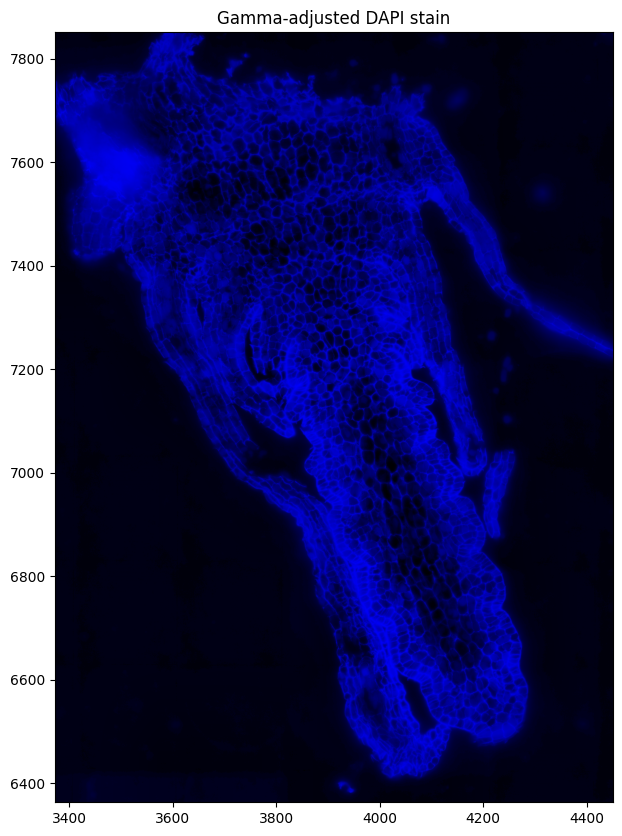

In [13]:
rgb_img, extent, warped_img = load_and_transform_stain(
    image_path='cell_segmentation/VGN1e_region1_output/images/mosaic_DAPI_z3.tif',
    transform_csv_path='cell_segmentation/VGN1e_region1_output/images/micron_to_mosaic_pixel_transform.csv',
    segmentation_df=merged_segmentation_df,
    gamma=0.75,  # (<1 brightens, >1 darkens)
    CLAHE = 0.02 # 0.01 = default
)

fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(rgb_img, extent=extent, origin='upper')
ax.set_title("Gamma-adjusted DAPI stain")
plt.show()

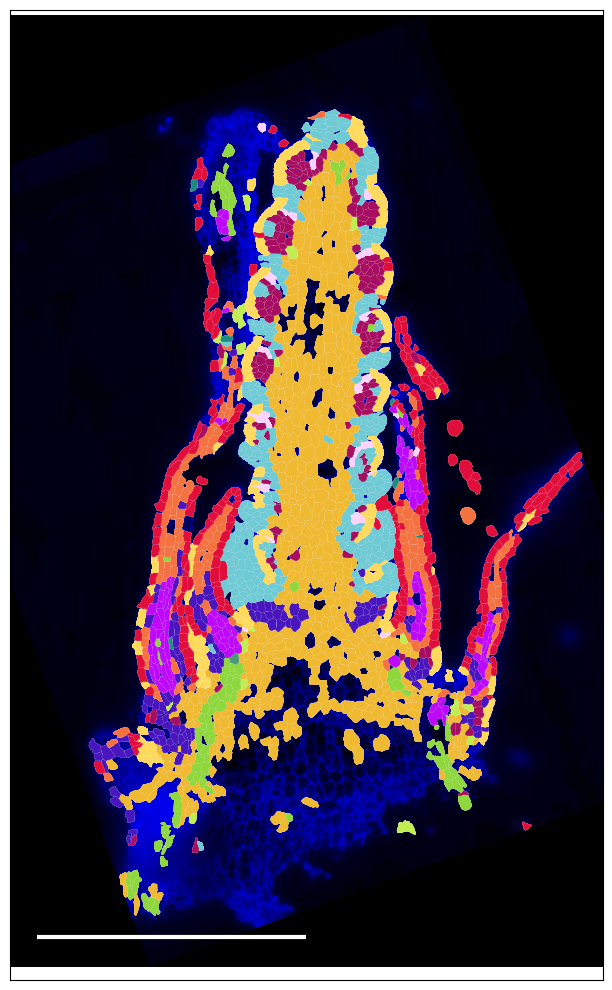

In [16]:
rotate_image_and_plot_clusters(
    segmentation_df=merged_segmentation_df,
    custom_cluster_colors={
        '0': '#a70e62',
        '1': '#e10e3c',
        '2': '#f47140',
        '3': '#f0b932',
        '4' : '#ffd95a',
        '5': '#c2ed51',
        '6': '#8ed73d',
        '7': '#489c73',
        '8': '#1a8d83',
        '9': '#4915be',
        '10': '#2357d5',
        '11': '#fed2ff', 
        '12': '#6ecad5',
        '13': '#bd08f9',
        '14': '#886fc2',
        '15': '#e170c0',
        '16': '#ff33cc', 
        '17': '#e4a9e8'
    },
    rgb_img=rgb_img,
    angle=-20,
    scale_bar_length=500,
    scale_bar_x_start=3450,
    scale_bar_y_start=6280,
    edge_color='white',
    default_edge_color='#FF000000',
    save_figure=True,
    save_path='leidenclustering/figures/VGN1e1_domainmap_wstain_500umscale.png',
    dpi=500,
    show_axis_ticks=False, 
    linewidth=0.05,
    xlim=(3400, 4500),
    ylim=(6200, 8000),
)


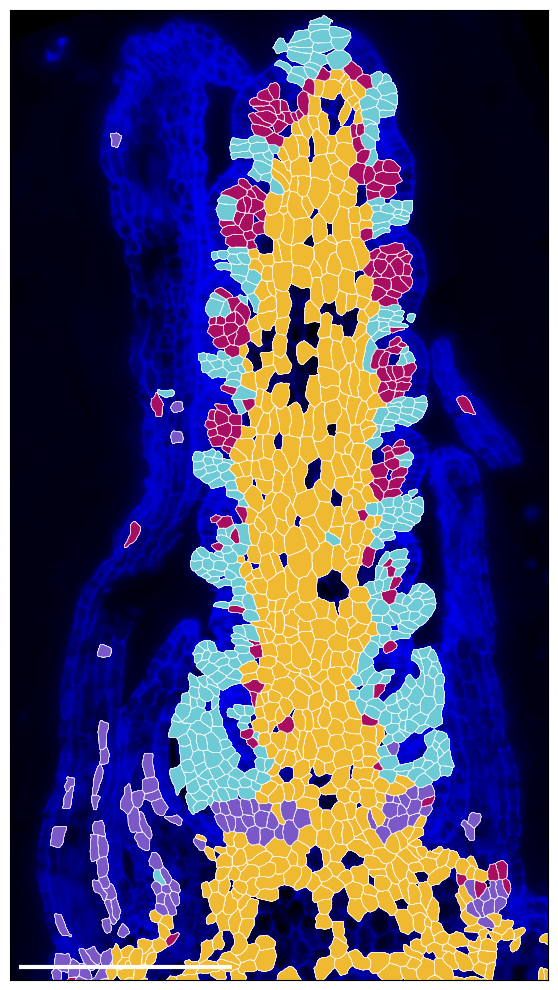

In [17]:
rotate_image_and_plot_clusters(
    segmentation_df=merged_segmentation_df,
    custom_cluster_colors={
        '0': '#a70e62', 
        '12': '#6ecad5',
        '9': '#7A58C7', 
        '3': '#f0b932'  
    },
    rgb_img=rgb_img,
    angle=-22,
    xlim=(3610, 4240),
    ylim=(6690, 7825),
    scale_bar_length=250,
    scale_bar_x_start=3620,
    scale_bar_y_start=6705,
    edge_color='white',
    default_edge_color='#FF000000',
    save_figure=True,
    save_path='enrichmentanalysis/figures/VGN1e1_domainmap_250scalebar_wstain_250umscale.png',
    dpi=500,
    show_axis_ticks=False, 
    linewidth=0.4
)


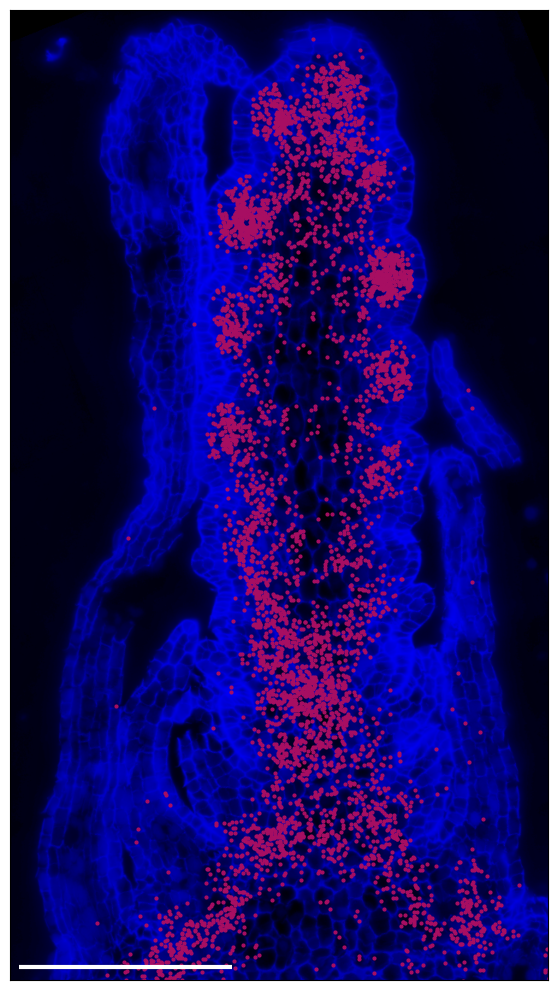

In [18]:
rotate_image_and_transcripts_only(
    warped_img=warped_img,
    segmentation_df=merged_segmentation_df,
    transcripts_df=filtered_transcripts_df,
    genes_of_interest={'TraesCS4A02G256700': '#a70e62'},
    angle=-22,
    rgb_img = rgb_img,
    xlim=(3610, 4240),
    ylim=(6690, 7825),
    scale_bar_length=250,
    scale_bar_x_start=3620,
    scale_bar_y_start=6705,
    edge_color='white',
    face_color='none',
    save_figure = True,
    save_path='enrichmentanalysis/figures/VGN1e1_KNOX5map_withstain_250scalebar.png',
    dpi=500,
    show_axis_ticks=False,
    linewidth=0.3,
    pointsize=4,
)

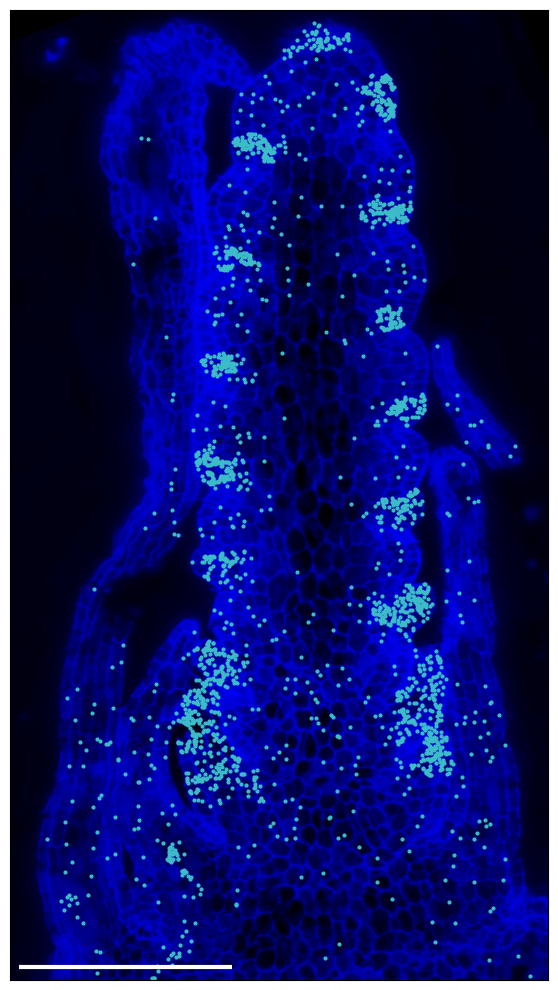

In [19]:
rotate_image_and_transcripts_only(
    warped_img=warped_img,
    segmentation_df=merged_segmentation_df,
    transcripts_df=filtered_transcripts_df,
    genes_of_interest={'TraesCS1A02G418200': '#3CBBC8'},
    angle=-22,
    rgb_img = rgb_img,
    xlim=(3610, 4240),
    ylim=(6690, 7825),
    scale_bar_length=250,
    scale_bar_x_start=3620,
    scale_bar_y_start=6705,
    edge_color='white',
    face_color='none',
    save_figure = True,
    save_path='enrichmentanalysis/figures/VGN1e1_NL1map_wstain_250scalebar.png',
    dpi=500,
    show_axis_ticks=False,
    linewidth=0.3,
    pointsize=4,
)

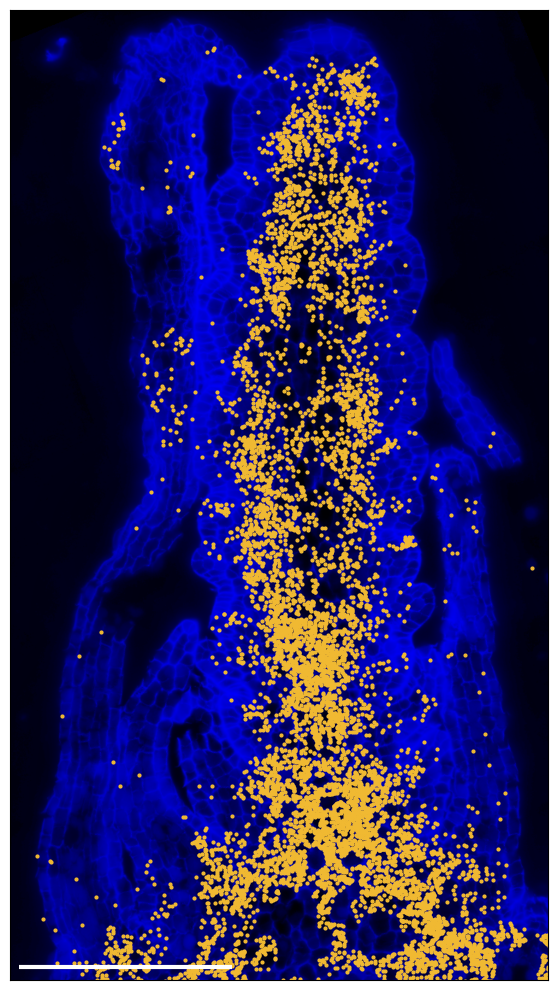

In [20]:
rotate_image_and_transcripts_only(
    warped_img=warped_img,
    segmentation_df=merged_segmentation_df,
    transcripts_df=filtered_transcripts_df,
    genes_of_interest={'TraesCS1B02G042200': '#f0b932'},
    angle=-22,
    rgb_img = rgb_img,
    xlim=(3610, 4240),
    ylim=(6690, 7825),
    scale_bar_length=250,
    scale_bar_x_start=3620,
    scale_bar_y_start=6705,
    edge_color='white',
    face_color='none',
    save_figure = True,
    save_path='enrichmentanalysis/figures/VGN1e1_MT2map_wstain_250scalebar.png',
    dpi=500,
    show_axis_ticks=False,
    linewidth=0.3,
    pointsize=4,
)

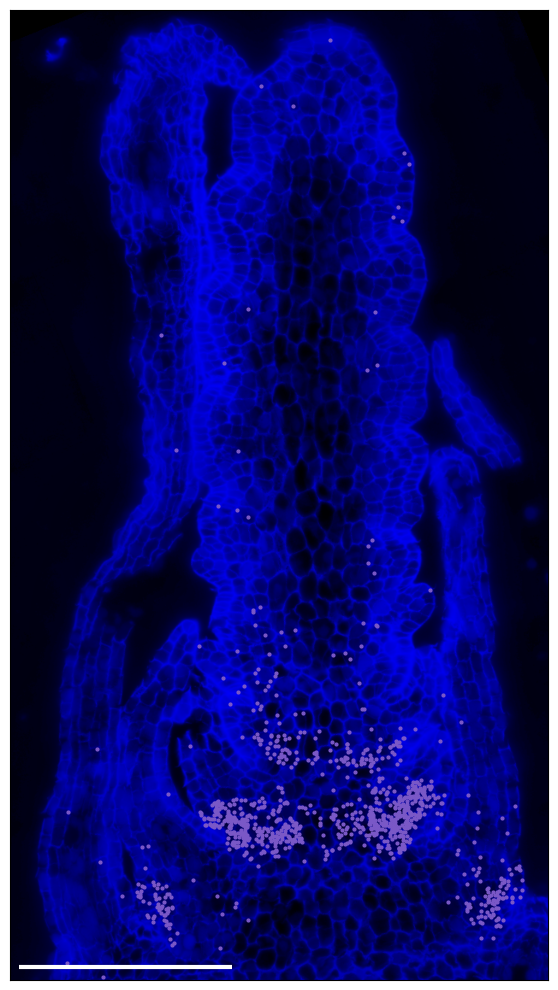

In [21]:
rotate_image_and_transcripts_only(
    warped_img=warped_img,
    segmentation_df=merged_segmentation_df,
    transcripts_df=filtered_transcripts_df,
    genes_of_interest={'TraesCS7B02G413900': '#7A58C7'},
    angle=-22,
    rgb_img = rgb_img,
    xlim=(3610, 4240),
    ylim=(6690, 7825),
    scale_bar_length=250,
    scale_bar_x_start=3620,
    scale_bar_y_start=6705,
    edge_color='white',
    face_color='none',
    save_figure = True,
    save_path='enrichmentanalysis/figures/VGN1e1_MNDmap_wstain_250scalebar.png',
    dpi=500,
    show_axis_ticks=False,
    linewidth=0.3,
    pointsize=4,
)

## VGN1e9 P1-POL Late Double Ridge 

In [22]:
filtered_transcripts_df, merged_segmentation_df = get_transcripts_and_segmentation(
    adata_spatial=adata_spatial,
    sample_name='VGN1e9',
    segmentation_path='cell_segmentation/VGN1e_region9_output/cellpose2_micron_space_VGN1e9.parquet',
    transcripts_path='cell_segmentation/VGN1e_region9_output/detected_transcripts_VGN1e9.csv'
)

min_x, min_y, max_x, max_y = get_segmentation_bounds(merged_segmentation_df)

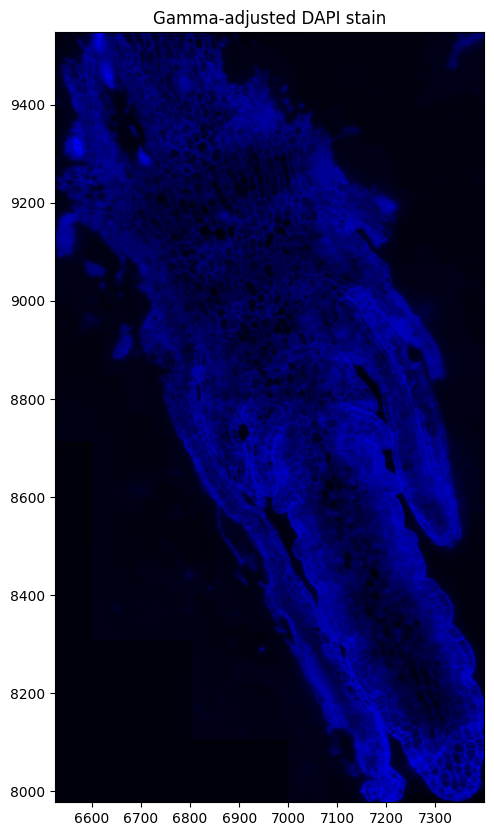

In [23]:
rgb_img, extent, warped_img = load_and_transform_stain(
    image_path='cell_segmentation/VGN1e_region9_output/images/mosaic_DAPI_z3.tif',
    transform_csv_path='cell_segmentation/VGN1e_region9_output/images/micron_to_mosaic_pixel_transform.csv',
    segmentation_df=merged_segmentation_df,
    gamma=0.75,  # (<1 brightens, >1 darkens)
    CLAHE = 0.02 # 0.01 = default
)

fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(rgb_img, extent=extent, origin='upper')
ax.set_title("Gamma-adjusted DAPI stain")
plt.show()

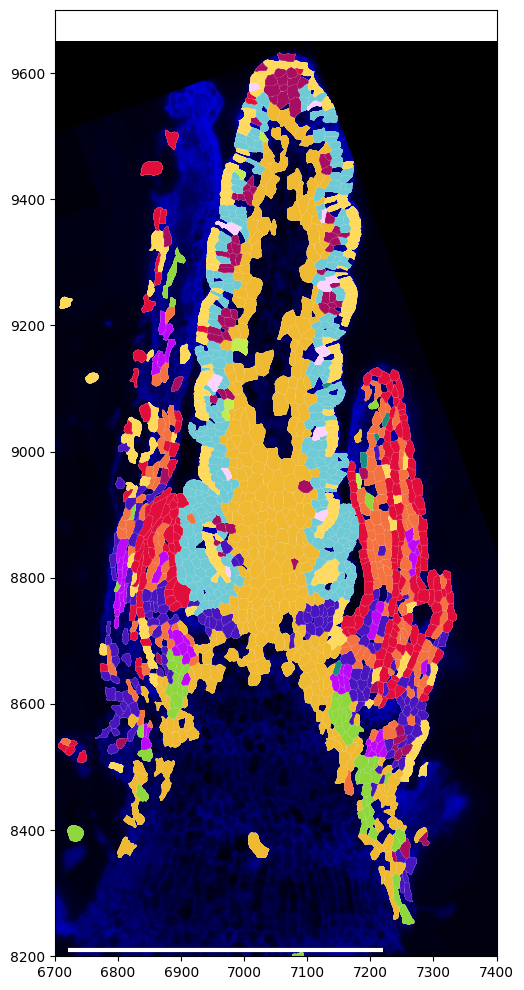

In [24]:
rotate_image_and_plot_clusters(
    segmentation_df=merged_segmentation_df,
    custom_cluster_colors={
        '0': '#a70e62',
        '1': '#e10e3c',
        '2': '#f47140',
        '3': '#f0b932',
        '4' : '#ffd95a',
        '5': '#c2ed51',
        '6': '#8ed73d',
        '7': '#489c73',
        '8': '#1a8d83',
        '9': '#4915be',
        '10': '#2357d5',
        '11': '#fed2ff', 
        '12': '#6ecad5',
        '13': '#bd08f9',
        '14': '#886fc2',
        '15': '#e170c0',
        '16': '#ff33cc', 
        '17': '#e4a9e8'
    },
    rgb_img=rgb_img,
    angle=-20,
    scale_bar_length=500,
    scale_bar_x_start=6720,
    scale_bar_y_start=8210,
    edge_color='white',
    default_edge_color='#FF000000',
    save_figure=True,
    save_path='leidenclustering/figures/VGN1e9_domainmap_wstain_500umscale.png',
    dpi=500,
    show_axis_ticks=True, 
    linewidth=0.05,
    xlim=(6700, 7400),
    ylim=(8200, 9700),
)


## VGN1b6 WT Lemma Primordia

In [21]:
filtered_transcripts_df, merged_segmentation_df = get_transcripts_and_segmentation(
    adata_spatial=adata_spatial,
    sample_name='VGN1b6',
    segmentation_path='cell_segmentation/VGN1b_region6_output/cellpose2_micron_space_VGN1b6.parquet',
    transcripts_path='cell_segmentation/VGN1b_region6_output/detected_transcripts_VGN1b6.csv'
)

min_x, min_y, max_x, max_y = get_segmentation_bounds(merged_segmentation_df)

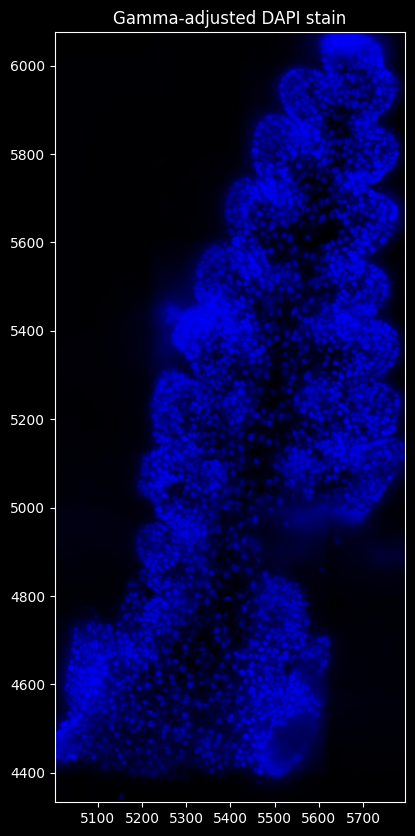

In [22]:
rgb_img, extent, warped_img = load_and_transform_stain(
    image_path='cell_segmentation/VGN1b_region6_output/images/mosaic_DAPI_z3.tif',
    transform_csv_path='cell_segmentation/VGN1b_region6_output/images/micron_to_mosaic_pixel_transform.csv',
    segmentation_df=merged_segmentation_df,
    gamma=1,  # (<1 brightens, >1 darkens)
    CLAHE = 0.01 # 0.01 = default
)

fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(rgb_img, extent=extent, origin='upper')
ax.set_title("Gamma-adjusted DAPI stain")
plt.show()

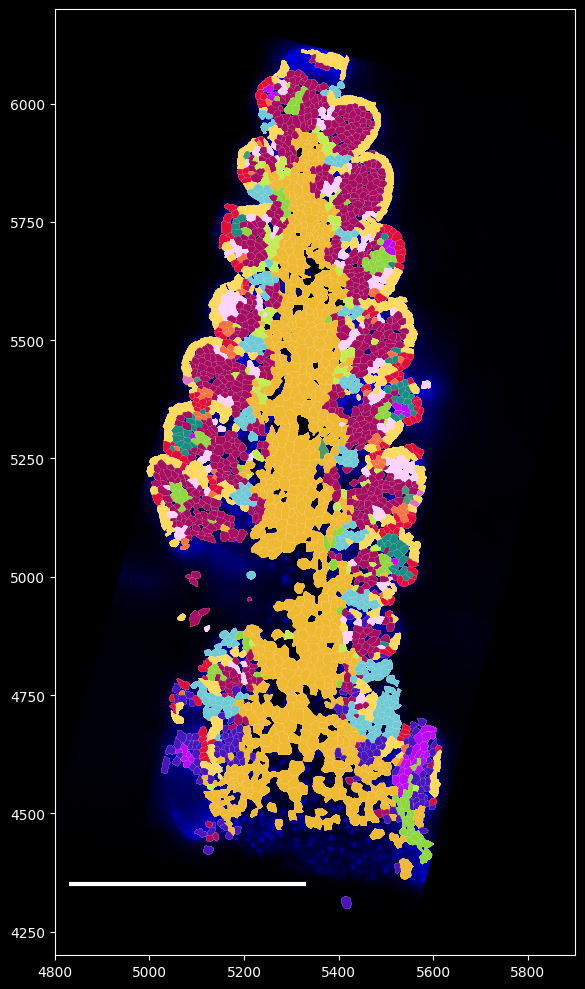

In [23]:
rotate_image_and_plot_clusters(
    segmentation_df=merged_segmentation_df,
    custom_cluster_colors={
        '0': '#a70e62',
        '1': '#e10e3c',
        '2': '#f47140',
        '3': '#f0b932',
        '4' : '#ffd95a',
        '5': '#c2ed51',
        '6': '#8ed73d',
        '7': '#489c73',
        '8': '#1a8d83',
        '9': '#4915be',
        '10': '#2357d5',
        '11': '#fed2ff', 
        '12': '#6ecad5',
        '13': '#bd08f9',
        '14': '#886fc2',
        '15': '#e170c0',
        '16': '#ff33cc', 
        '17': '#e4a9e8'
    },
    rgb_img=rgb_img,
    angle=-165,
    scale_bar_length=500,
    scale_bar_x_start=4830,
    scale_bar_y_start=4350,
    edge_color='white',
    default_edge_color='#FF000000',
    save_figure=True,
    save_path='leidenclustering/figures/VGN1b6_domainmap_wstain_500umscale.png',
    dpi=500,
    show_axis_ticks=True, 
    linewidth=0.05,
    xlim=(4800, 5900),
    ylim=(4200, 6200),
)


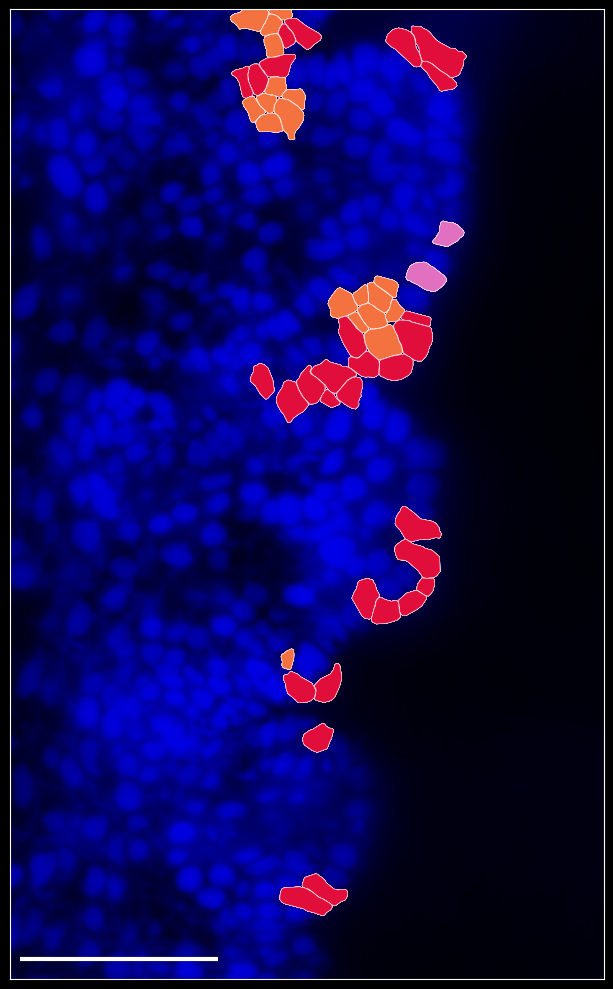

In [24]:
rotate_image_and_plot_clusters(
    segmentation_df=merged_segmentation_df,
    custom_cluster_colors={
        '1': '#e10e3c',
        '2': '#f47140',
        '15': '#e170c0'
    },
    rgb_img=rgb_img,
    angle=-165,
    scale_bar_length=100,
    scale_bar_x_start=5355,
    scale_bar_y_start=4810,
    edge_color='white',
    default_edge_color='#FF000000',
    save_figure=True,
    save_path='enrichmentanalysis/figures/VGN1b6_spikelet_ED15_100umscale.png',
    dpi=500,
    show_axis_ticks=False, 
    linewidth=0.3,
    xlim=(5350, 5650),
    ylim=(4800, 5290),
)

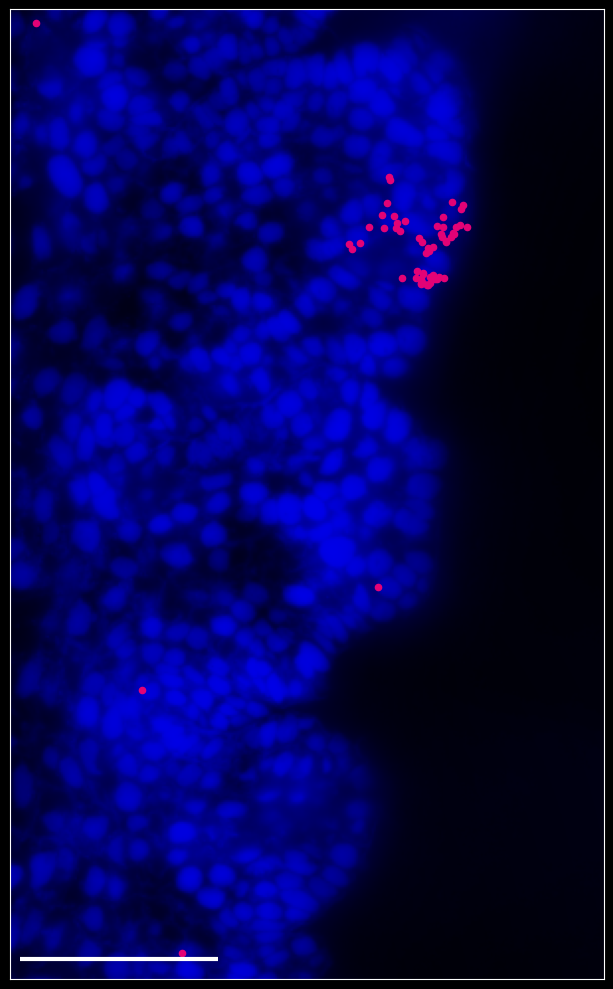

In [27]:
rotate_image_and_transcripts_only(
    warped_img=warped_img,
    segmentation_df=merged_segmentation_df,
    transcripts_df=filtered_transcripts_df,
    genes_of_interest={'TraesCS6A02G259000': '#E30276'},
    angle=-165,
    rgb_img = rgb_img,
    scale_bar_length=100,
    scale_bar_x_start=5355,
    scale_bar_y_start=4810,
    edge_color='black',
    face_color='none',
    save_figure = True,
    save_path='enrichmentanalysis/figures/AGL6_VGN1b6_transcripts_stain_100umscale.png',
    dpi=500,
    show_axis_ticks=False,
    linewidth=0.3,
    pointsize=20,
    xlim=(5350, 5650),
    ylim=(4800, 5290),
)

## VGN1b8 P1-POL Lemma Primordia 

In [30]:
filtered_transcripts_df, merged_segmentation_df = get_transcripts_and_segmentation(
    adata_spatial=adata_spatial,
    sample_name='VGN1b8',
    segmentation_path='cell_segmentation/VGN1b_region8_output/cellpose2_micron_space_VGN1b8.parquet',
    transcripts_path='cell_segmentation/VGN1b_region8_output/detected_transcripts_VGN1b8.csv'
)

min_x, min_y, max_x, max_y = get_segmentation_bounds(merged_segmentation_df)

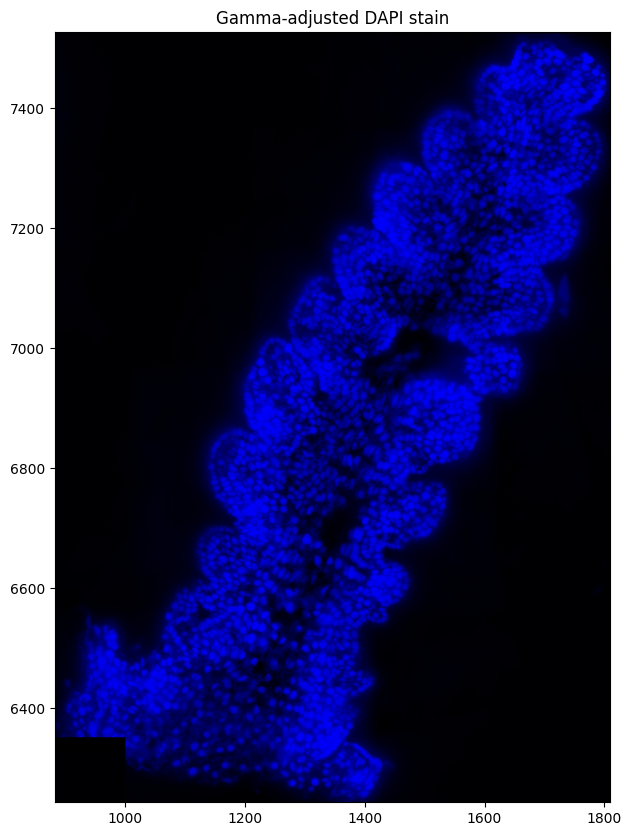

In [31]:
rgb_img, extent, warped_img = load_and_transform_stain(
    image_path='cell_segmentation/VGN1b_region8_output/images/mosaic_DAPI_z3.tif',
    transform_csv_path='cell_segmentation/VGN1b_region8_output/images/micron_to_mosaic_pixel_transform.csv',
    segmentation_df=merged_segmentation_df,
    gamma=1,  # (<1 brightens, >1 darkens)
    CLAHE = 0.01 # 0.01 = default
)

fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(rgb_img, extent=extent, origin='upper')
ax.set_title("Gamma-adjusted DAPI stain")
plt.show()

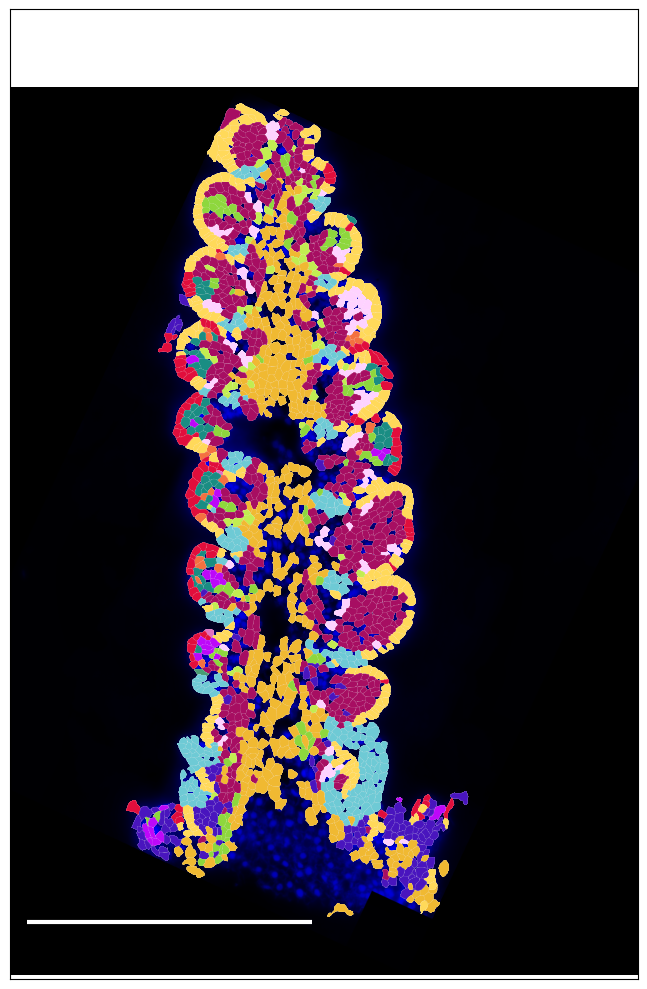

In [32]:
rotate_image_and_plot_clusters(
    segmentation_df=merged_segmentation_df,
    custom_cluster_colors={
        '0': '#a70e62',
        '1': '#e10e3c',
        '2': '#f47140',
        '3': '#f0b932',
        '4' : '#ffd95a',
        '5': '#c2ed51',
        '6': '#8ed73d',
        '7': '#489c73',
        '8': '#1a8d83',
        '9': '#4915be',
        '10': '#2357d5',
        '11': '#fed2ff', 
        '12': '#6ecad5',
        '13': '#bd08f9',
        '14': '#886fc2',
        '15': '#e170c0',
        '16': '#ff33cc', 
        '17': '#e4a9e8'
    },
    rgb_img=rgb_img,
    angle=-155,
    scale_bar_length=500,
    scale_bar_x_start=830,
    scale_bar_y_start=6200,
    edge_color='white',
    default_edge_color='#FF000000',
    save_figure=True,
    save_path='leidenclustering/figures/VGN1b8_domainmap_wstain_500umscale.png',
    dpi=500,
    show_axis_ticks=False, 
    linewidth=0.05,
    xlim=(800, 1900),
    ylim=(6100, 7800),
)


## VGN1a6 WT Terminal Spikelet

In [28]:
filtered_transcripts_df, merged_segmentation_df = get_transcripts_and_segmentation(
    adata_spatial=adata_spatial,
    sample_name='VGN1a6',
    segmentation_path='cell_segmentation/VGN1a_region6_output/cellpose2_micron_space_VGN1a6.parquet',
    transcripts_path='cell_segmentation/VGN1a_region6_output/detected_transcripts.csv'
)

min_x, min_y, max_x, max_y = get_segmentation_bounds(merged_segmentation_df)

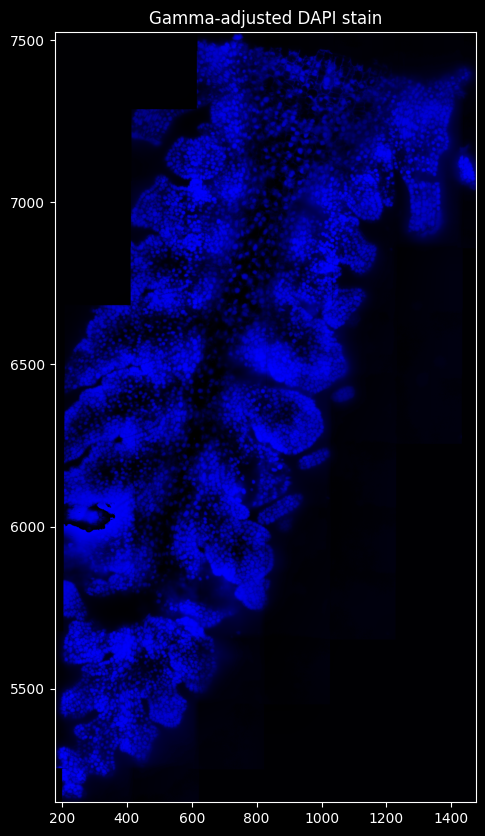

In [29]:
rgb_img, extent, warped_img = load_and_transform_stain(
    image_path='cell_segmentation/VGN1a_region6_output/images/mosaic_DAPI_z3.tif',
    transform_csv_path='cell_segmentation/VGN1a_region6_output/images/micron_to_mosaic_pixel_transform.csv',
    segmentation_df=merged_segmentation_df,
    gamma=1.3,  # (<1 brightens, >1 darkens)
    CLAHE = 0.04
)

fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(rgb_img, extent=extent, origin='upper')
ax.set_title("Gamma-adjusted DAPI stain")
plt.show()

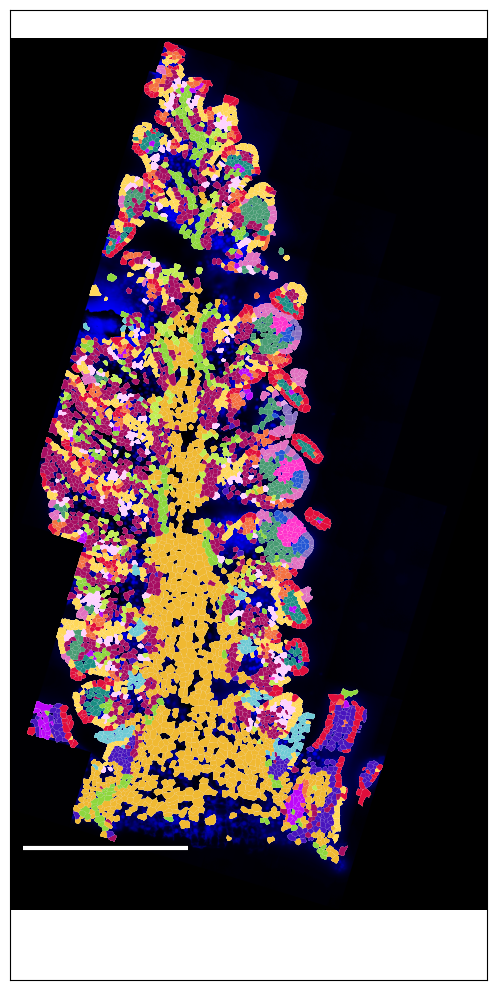

In [35]:
rotate_image_and_plot_clusters(
    segmentation_df=merged_segmentation_df,
    custom_cluster_colors={
        '0': '#a70e62',
        '1': '#e10e3c',
        '2': '#f47140',
        '3': '#f0b932',
        '4' : '#ffd95a',
        '5': '#c2ed51',
        '6': '#8ed73d',
        '7': '#489c73',
        '8': '#1a8d83',
        '9': '#4915be',
        '10': '#2357d5',
        '11': '#fed2ff', 
        '12': '#6ecad5',
        '13': '#bd08f9',
        '14': '#886fc2',
        '15': '#e170c0',
        '16': '#ff33cc', 
        '17': '#e4a9e8'
    },
    rgb_img=rgb_img,
    angle=17,
    scale_bar_length=500,
    scale_bar_x_start=140,
    scale_bar_y_start=5200,
    edge_color='white',
    default_edge_color='#FF000000',
    save_figure=True,
    save_path='leidenclustering/figures/VGN1a6_domainmap_withstain_500umscale.png',
    dpi=500,
    show_axis_ticks=False, 
    linewidth=0.05,
    xlim=(100, 1550),
    ylim=(4800, 7750),
)


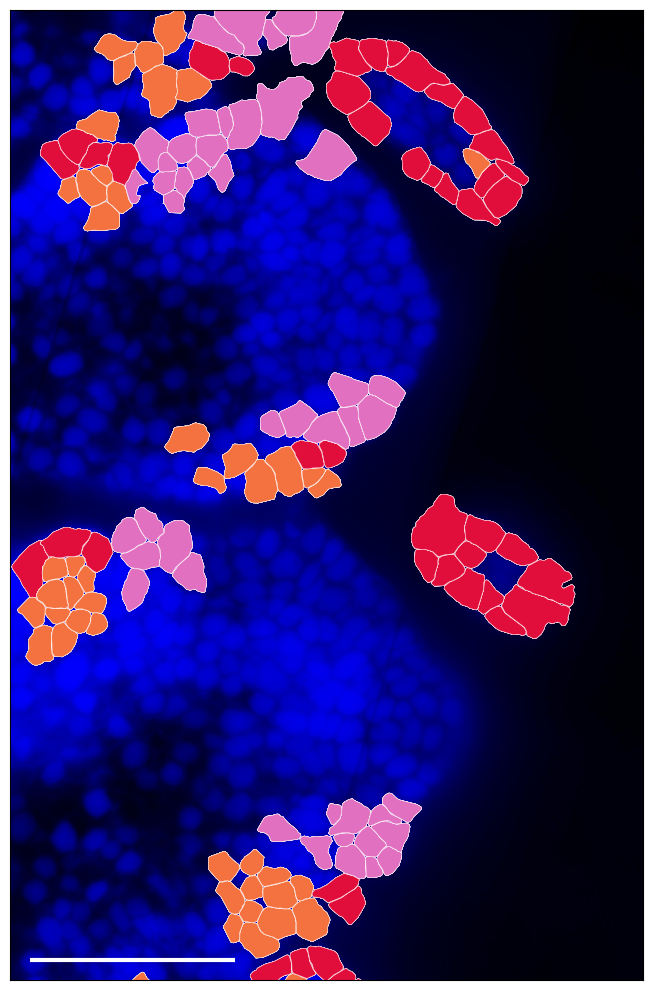

In [36]:
rotate_image_and_plot_clusters(
    segmentation_df=merged_segmentation_df,
    custom_cluster_colors={
        '1': '#e10e3c',
        '2': '#f47140',
        '15': '#e170c0'
    },
    rgb_img=rgb_img,
    angle=17,
    scale_bar_length=100,
    scale_bar_x_start=810,
    scale_bar_y_start=6010,
    edge_color='white',
    default_edge_color='#FF000000',
    save_figure=True,
    save_path='enrichmentanalysis/VGN1a6_spikelet_ED15_100umscale.png',
    dpi=500,
    show_axis_ticks=False, 
    linewidth=0.3,
    xlim=(800, 1110),
    ylim=(6000, 6475),
)

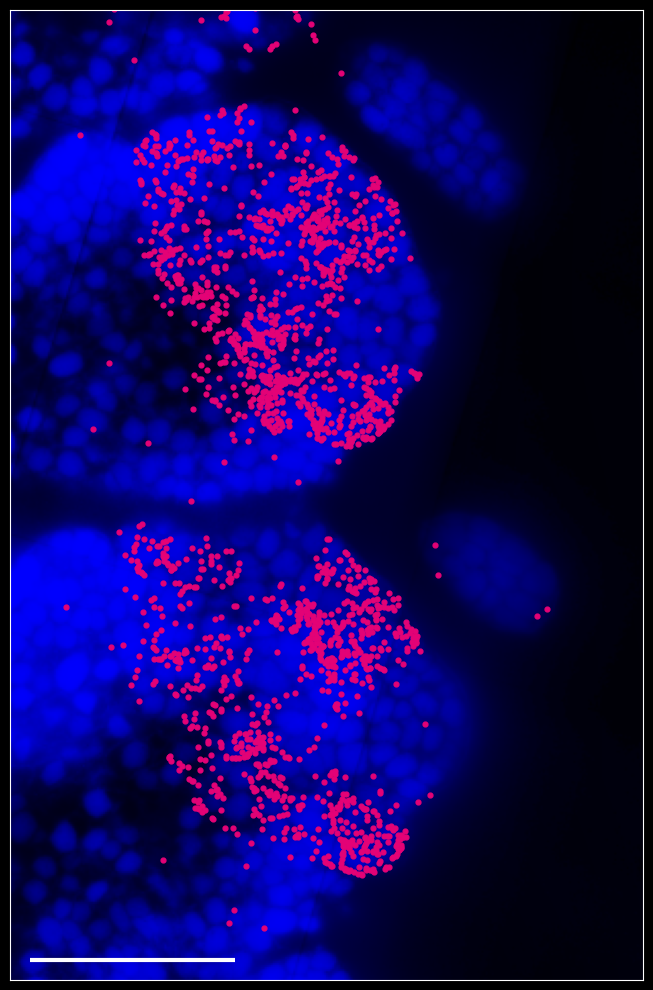

In [30]:
rotate_image_and_transcripts_only(
    warped_img=warped_img,
    segmentation_df=merged_segmentation_df,
    transcripts_df=filtered_transcripts_df,
    genes_of_interest={'TraesCS6A02G259000': '#E30276'},
    angle=17,
    rgb_img = rgb_img,
    scale_bar_length=100,
    scale_bar_x_start=810,
    scale_bar_y_start=6010,
    edge_color='white',
    face_color='none',
    save_figure = True,
    save_path='enrichmentanalysis/figures/AGL6_VGN1a6_transcripts_stain_100um.png',
    dpi=500,
    show_axis_ticks=False,
    linewidth=0.3,
    pointsize=12,
    xlim=(800, 1110),
    ylim=(6000, 6475),
)

## VGN1a4 P1 Pol Terminal Spikelet

In [38]:
filtered_transcripts_df, merged_segmentation_df = get_transcripts_and_segmentation(
    adata_spatial=adata_spatial,
    sample_name='VGN1a4',
    segmentation_path='cell_segmentation/VGN1a_region4_output/cellpose2_micron_space_VGN1a4.parquet',
    transcripts_path='cell_segmentation/VGN1a_region4_output/detected_transcripts_VGN1a4.csv'
)

min_x, min_y, max_x, max_y = get_segmentation_bounds(merged_segmentation_df)

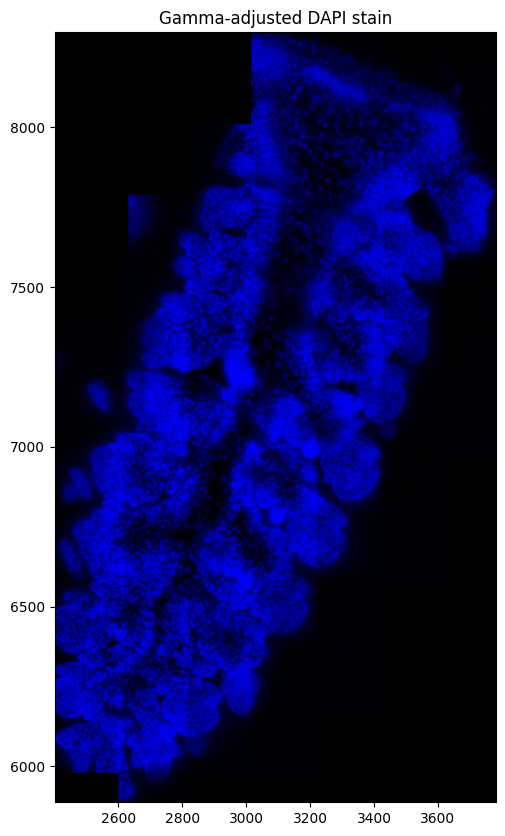

In [39]:
rgb_img, extent, warped_img = load_and_transform_stain(
    image_path='cell_segmentation/VGN1a_region4_output/images/mosaic_DAPI_z3.tif',
    transform_csv_path='cell_segmentation/VGN1a_region4_output/images/micron_to_mosaic_pixel_transform.csv',
    segmentation_df=merged_segmentation_df,
    gamma=1,  # (<1 brightens, >1 darkens)
    CLAHE = 0.01
)

fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(rgb_img, extent=extent, origin='upper')
ax.set_title("Gamma-adjusted DAPI stain")
plt.show()

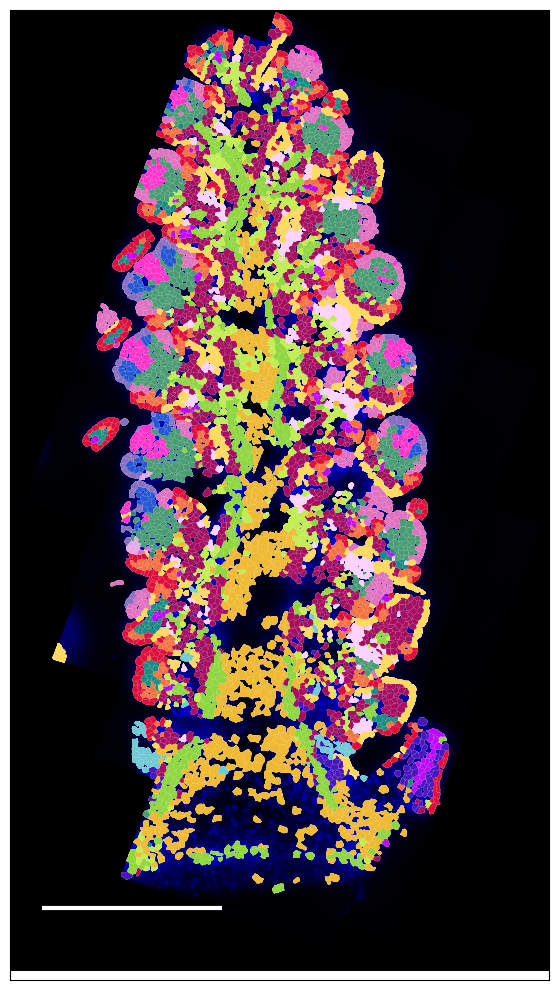

In [40]:
rotate_image_and_plot_clusters(
    segmentation_df=merged_segmentation_df,
    custom_cluster_colors={
        '0': '#a70e62',
        '1': '#e10e3c',
        '2': '#f47140',
        '3': '#f0b932',
        '4' : '#ffd95a',
        '5': '#c2ed51',
        '6': '#8ed73d',
        '7': '#489c73',
        '8': '#1a8d83',
        '9': '#4915be',
        '10': '#2357d5',
        '11': '#fed2ff', 
        '12': '#6ecad5',
        '13': '#bd08f9',
        '14': '#886fc2',
        '15': '#e170c0',
        '16': '#ff33cc', 
        '17': '#e4a9e8'
    },
    rgb_img=rgb_img,
    angle=20,
    scale_bar_length=500,
    scale_bar_x_start=2390,
    scale_bar_y_start=5900,
    edge_color='white',
    default_edge_color='#FF000000',
    save_figure=True,
    save_path='leidenclustering/VGN1a4_domainmap_withstain_500umscale.png',
    dpi=500,
    show_axis_ticks=False, 
    linewidth=0.05,
    xlim=(2300, 3800),
    ylim=(5700, 8400),
)


## VGN1c3 Pl Pol Carpel Extension Round 

In [41]:
filtered_transcripts_df, merged_segmentation_df = get_transcripts_and_segmentation(
    adata_spatial=adata_spatial,
    sample_name='VGN1c3',
    segmentation_path='cell_segmentation/VGN1c_region3_output/cellpose2_micron_space_VGN1c3.parquet',
    transcripts_path='cell_segmentation/VGN1c_region3_output/detected_transcripts_VGN1c3.csv'
)

min_x, min_y, max_x, max_y = get_segmentation_bounds(merged_segmentation_df)

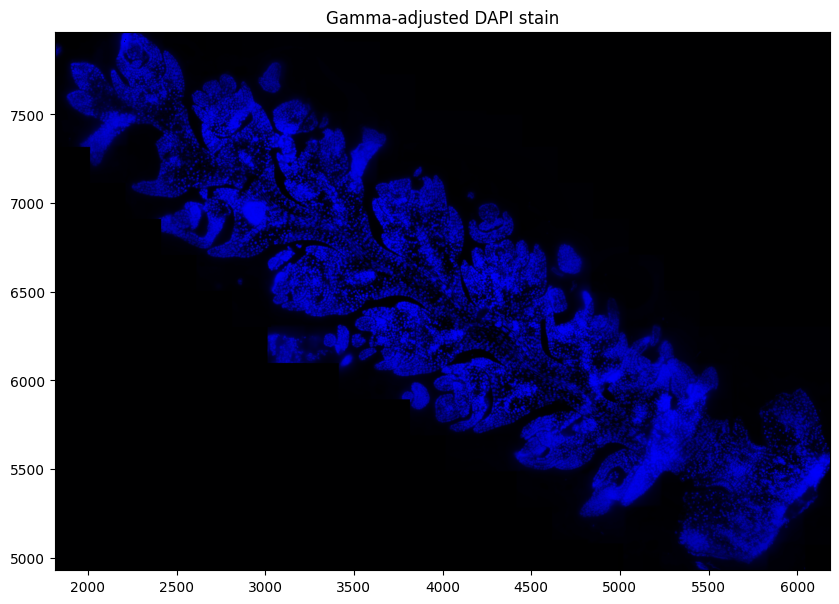

In [42]:
rgb_img, extent, warped_img = load_and_transform_stain(
    image_path='cell_segmentation/VGN1c_region3_output/images/mosaic_DAPI_z3.tif',
    transform_csv_path='cell_segmentation/VGN1c_region3_output/images/micron_to_mosaic_pixel_transform.csv',
    segmentation_df=merged_segmentation_df,
    gamma=1.4,  # (<1 brightens, >1 darkens)
    CLAHE = 0.03
)

fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(rgb_img, extent=extent, origin='upper')
ax.set_title("Gamma-adjusted DAPI stain")
plt.show()

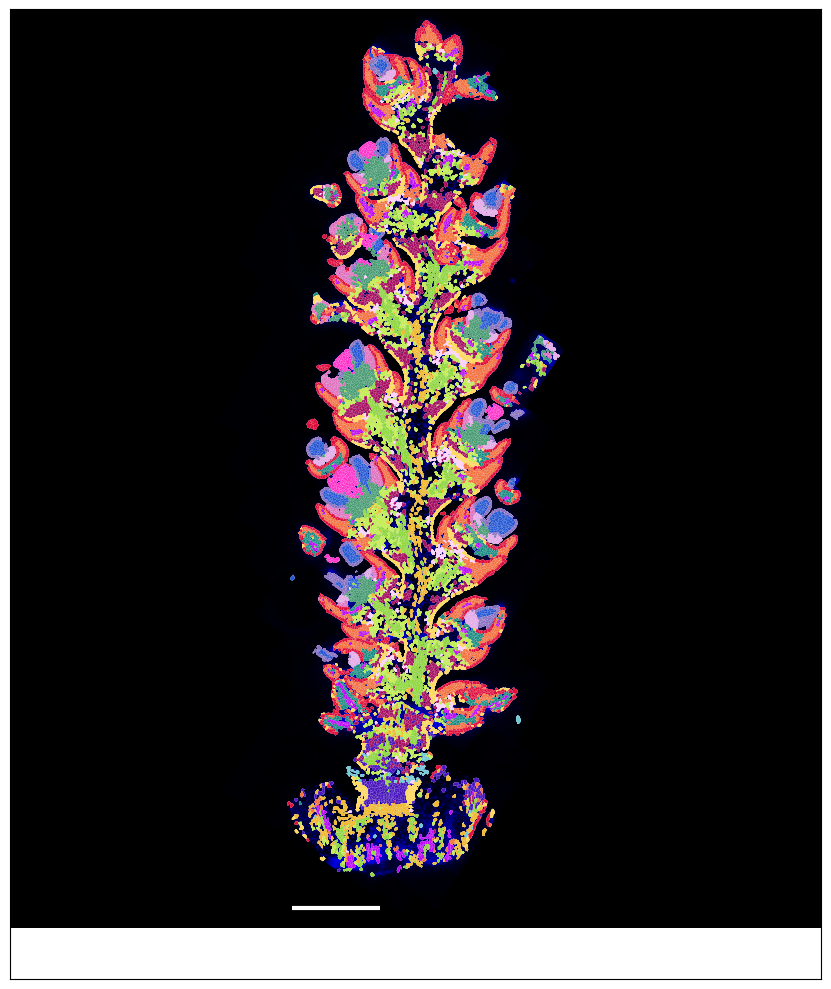

In [43]:
rotate_image_and_plot_clusters(
    segmentation_df=merged_segmentation_df,
    custom_cluster_colors={
        '0': '#a70e62',
        '1': '#e10e3c',
        '2': '#f47140',
        '3': '#f0b932',
        '4' : '#ffd95a',
        '5': '#c2ed51',
        '6': '#8ed73d',
        '7': '#489c73',
        '8': '#1a8d83',
        '9': '#4915be',
        '10': '#2357d5',
        '11': '#fed2ff', 
        '12': '#6ecad5',
        '13': '#bd08f9',
        '14': '#886fc2',
        '15': '#e170c0',
        '16': '#ff33cc', 
        '17': '#e4a9e8'
    },
    rgb_img=rgb_img,
    angle=124,
    scale_bar_length=500,
    scale_bar_x_start=3300,
    scale_bar_y_start=3900,
    edge_color='white',
    default_edge_color='#FF000000',
    save_figure=True,
    save_path='leidenclustering/VGN1c3_domainmap_withstain_500umscale.png',
    dpi=500,
    show_axis_ticks=False, 
    linewidth=0.05,
    xlim=(1700, 6300),
    ylim=(3500, 9000),
)


## VGN1c2 WT Carpel Extension Round 

In [31]:
filtered_transcripts_df, merged_segmentation_df = get_transcripts_and_segmentation(
    adata_spatial=adata_spatial,
    sample_name='VGN1c2',
    segmentation_path='cell_segmentation/VGN1c_region2_output/cellpose2_micron_space_VGN1c2.parquet',
    transcripts_path='cell_segmentation/VGN1c_region2_output/detected_transcripts_VGN1c2.csv'
)

min_x, min_y, max_x, max_y = get_segmentation_bounds(merged_segmentation_df)

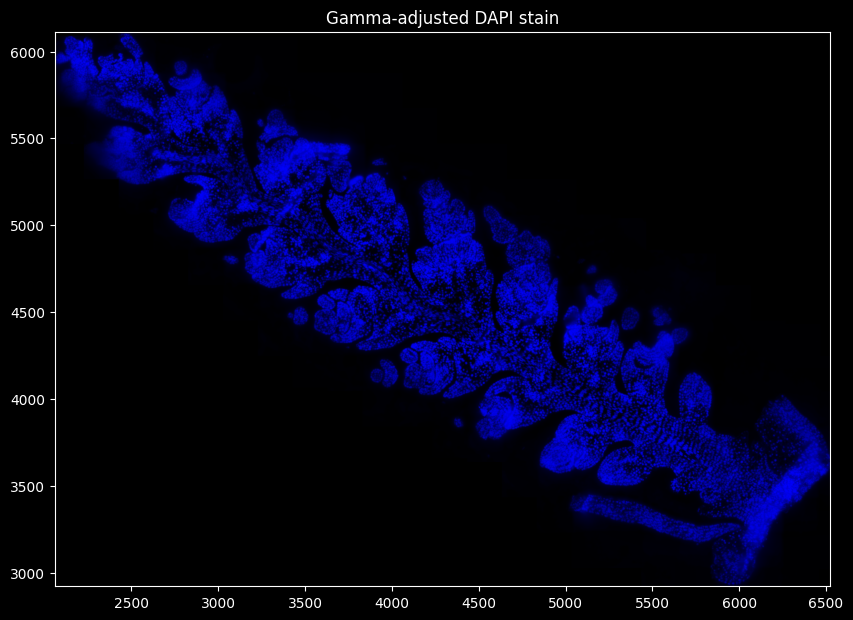

In [32]:
rgb_img, extent, warped_img = load_and_transform_stain(
    image_path='cell_segmentation/VGN1c_region2_output/images/mosaic_DAPI_z3.tif',
    transform_csv_path='cell_segmentation/VGN1c_region2_output/images/micron_to_mosaic_pixel_transform.csv',
    segmentation_df=merged_segmentation_df,
    gamma=1.4,  # (<1 brightens, >1 darkens)
    CLAHE = 0.03
)

fig, ax = plt.subplots(figsize=(10, 10))
ax.imshow(rgb_img, extent=extent, origin='upper')
ax.set_title("Gamma-adjusted DAPI stain")
plt.show()

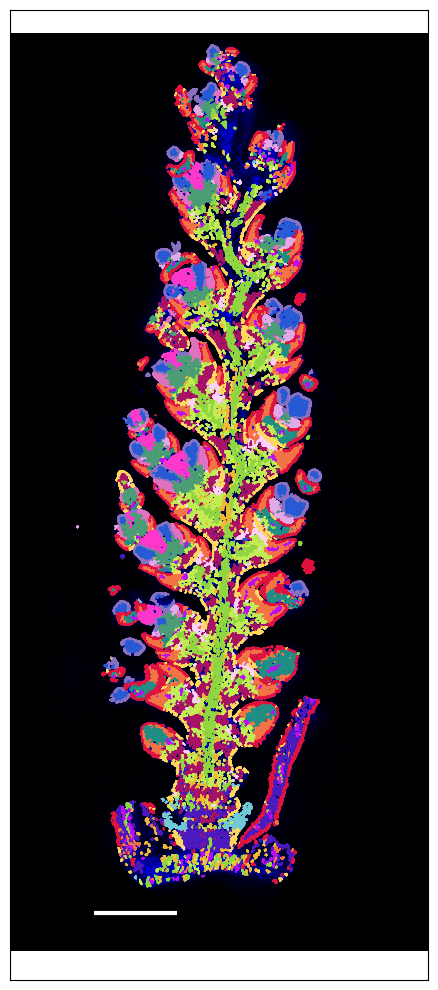

In [46]:
rotate_image_and_plot_clusters(
    segmentation_df=merged_segmentation_df,
    custom_cluster_colors={
        '0': '#a70e62',
        '1': '#e10e3c',
        '2': '#f47140',
        '3': '#f0b932',
        '4' : '#ffd95a',
        '5': '#c2ed51',
        '6': '#8ed73d',
        '7': '#489c73',
        '8': '#1a8d83',
        '9': '#4915be',
        '10': '#2357d5',
        '11': '#fed2ff', 
        '12': '#6ecad5',
        '13': '#bd08f9',
        '14': '#886fc2',
        '15': '#e170c0',
        '16': '#ff33cc', 
        '17': '#e4a9e8'
    },
    rgb_img=rgb_img,
    angle=124,
    scale_bar_length=500,
    scale_bar_x_start=3500,
    scale_bar_y_start=2000,
    edge_color='white',
    default_edge_color='#FF000000',
    save_figure=True,
    save_path='leidenclustering/VGN1c2_domainmap_withstain_500umscale.png',
    dpi=500,
    show_axis_ticks=False, 
    linewidth=0.01,
    xlim=(3000, 5500),
    ylim=(1600, 7400),
)


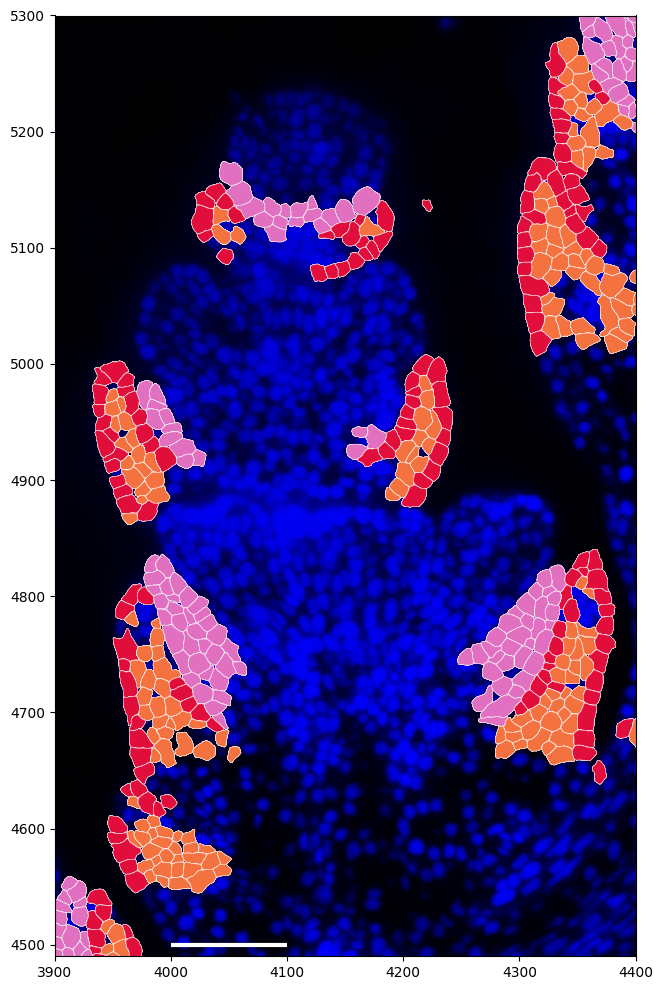

In [47]:
rotate_image_and_plot_clusters(
    segmentation_df=merged_segmentation_df,
    custom_cluster_colors={
        '1': '#e10e3c',
        '2': '#f47140',
        '15': '#e170c0'
    },
    rgb_img=rgb_img,
    angle=160,
    scale_bar_length=100,
    scale_bar_x_start=4000,
    scale_bar_y_start=4500,
    edge_color='white',
    default_edge_color='#FF000000',
    save_figure=True,
    save_path='leidenclustering/figures/VGN1c2_spikelet_ED15_100umscale.png',
    dpi=500,
    show_axis_ticks=True, 
    linewidth=0.3,
    xlim=(3900, 4400),
    ylim=(4490, 5300),
)


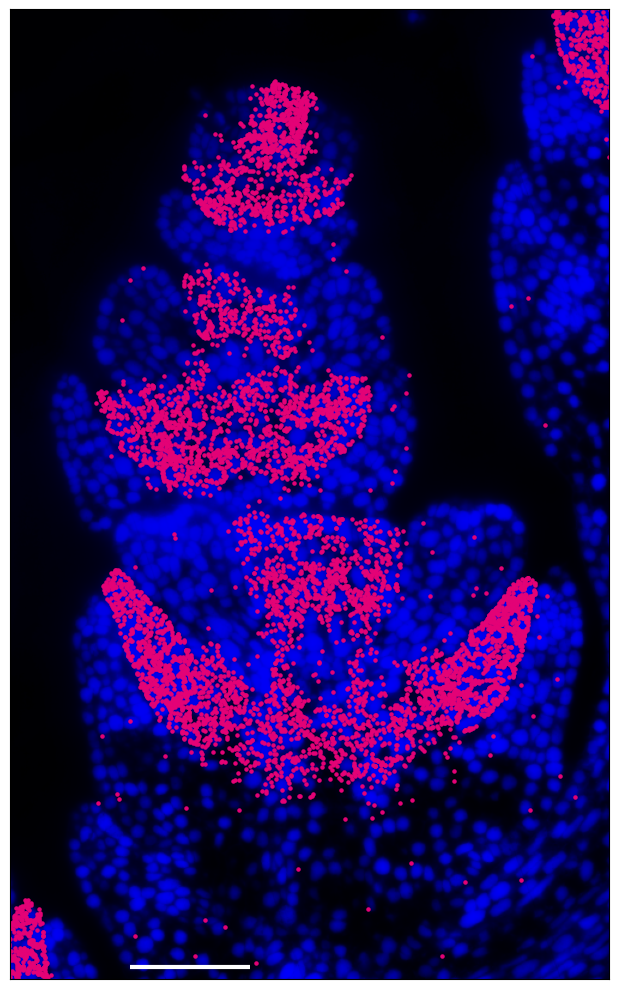

In [48]:
rotate_image_and_transcripts_only(
    warped_img=warped_img,
    segmentation_df=merged_segmentation_df,
    transcripts_df=filtered_transcripts_df,
    genes_of_interest={'TraesCS6A02G259000': '#E30276'},
    angle=160,
    scale_bar_length=100,
    scale_bar_x_start=4000,
    scale_bar_y_start=4500,
    rgb_img = rgb_img,
    edge_color='white',
    face_color='none',
    save_figure = True,
    save_path='enrichmentanalysis/figures/AGL6_VGN1c2_transcripts_stainingplot.png',
    dpi=500,
    show_axis_ticks=False,
    linewidth=0.3,
    pointsize=5,
    xlim=(3900, 4400),
    ylim=(4490, 5300),
)

## creating heatmap for supplemental figure 

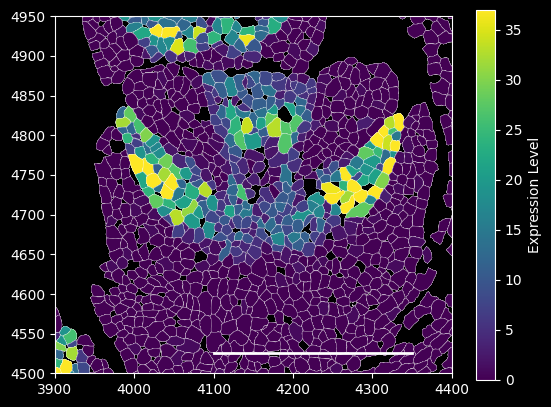

In [37]:
combined_cells_summary_matrix = pd.read_csv('qc/cellmetadata_genecounts_transcriptcounts.csv')
filtered_segmentation_df2 = merged_segmentation_df.copy()

combined_cells_summary_matrix['EntityID'] = combined_cells_summary_matrix['EntityID'].astype(str)
filtered_segmentation_df2['EntityID'] = filtered_segmentation_df2['EntityID'].astype(str)

# Merge dataframes on 'EntityID', keeping only the necessary column
filtered_segmentation_df2 = filtered_segmentation_df2.merge(
    combined_cells_summary_matrix[['EntityID', 'TraesCS6A02G259000']],
    on='EntityID',
    how='left'
)
# Rotation logic
if 'Original_Geometry' not in filtered_segmentation_df2.columns:
    filtered_segmentation_df2['Original_Geometry'] = filtered_segmentation_df2['Geometry']

# Define rotation angle in degrees
rotation_angle = -160
angle_rad = np.radians(rotation_angle)

# Calculate the rotation matrix components
cos_theta = np.cos(angle_rad)
sin_theta = np.sin(angle_rad)

# Get the centroid of the entire sample as the rotation origin
centroid_x = (min_x + max_x) / 2  # Use the previously computed min_x, max_x
centroid_y = (min_y + max_y) / 2  # Use the previously computed min_y, max_y

# Rotation matrix for Shapely's affine_transform (a, b, d, e, xoff, yoff)
rotation_matrix = [
    cos_theta, -sin_theta,  # a, b
    sin_theta, cos_theta,   # d, e
    centroid_x - cos_theta * centroid_x + sin_theta * centroid_y,  # xoff
    centroid_y - sin_theta * centroid_x - cos_theta * centroid_y   # yoff
]

# Rotate the original geometries
rotated_geometries = filtered_segmentation_df2['Original_Geometry'].apply(
    lambda geom: affine_transform(geom, rotation_matrix)
)
filtered_segmentation_df2['Geometry'] = rotated_geometries

# Initialize colormap
colormap = cm.get_cmap('viridis')  # You can use other colormaps like 'plasma' or 'cividis'
norm = colors.Normalize(vmin=0, vmax=37)

# Plot the heatmap
fig, ax = plt.subplots()
patches_list = []

for _, row in filtered_segmentation_df2.iterrows():
    shape = row['Geometry']
    normalized_value = row['TraesCS6A02G259000']
    color = colormap(norm(normalized_value))

    if isinstance(shape, MultiPolygon):
        for poly in shape.geoms:
            patch = patches.Polygon(
                list(poly.exterior.coords), closed=True, facecolor=color, edgecolor='white', linewidth=0.15
            )
            patches_list.append(patch)
    elif isinstance(shape, Polygon):
        patch = patches.Polygon(
            list(shape.exterior.coords), closed=True, facecolor=color, edgecolor='white', linewidth=0.15
        )
        patches_list.append(patch)

# Adjust axis limits if needed
ax.set_xlim([3900, 4400])
ax.set_ylim([4500, 4950])
ax.set_aspect('equal')

# Use PatchCollection to handle all patches
collection = PatchCollection(patches_list, match_original=True)
ax.add_collection(collection)

# Add the scale bar
scale_bar_length_microns = 250 # Length of scale bar in microns
scale_bar_x_start = 4100      # X-coordinate for the start of the scale bar
scale_bar_y_start = 4525       # Y-coordinate for the start of the scale bar
scale_bar_length_units = scale_bar_length_microns  # Assuming 1 unit = 1 micron

scale_bar = Line2D(
    [scale_bar_x_start, scale_bar_x_start + scale_bar_length_microns],
    [scale_bar_y_start, scale_bar_y_start],
    color="white",
    linewidth=2
)
ax.add_line(scale_bar)

# Add colorbar
plt.colorbar(cm.ScalarMappable(norm=norm, cmap=colormap), ax=ax, label="Expression Level")
ax.set_facecolor('black')
plt.savefig('leidenclustering/figures/VGN1c2_heatmapAGL6_floraltissues_100scalebar.png', dpi=700, bbox_inches='tight', format='png')
plt.show()


## Creating ABCDE model figures 

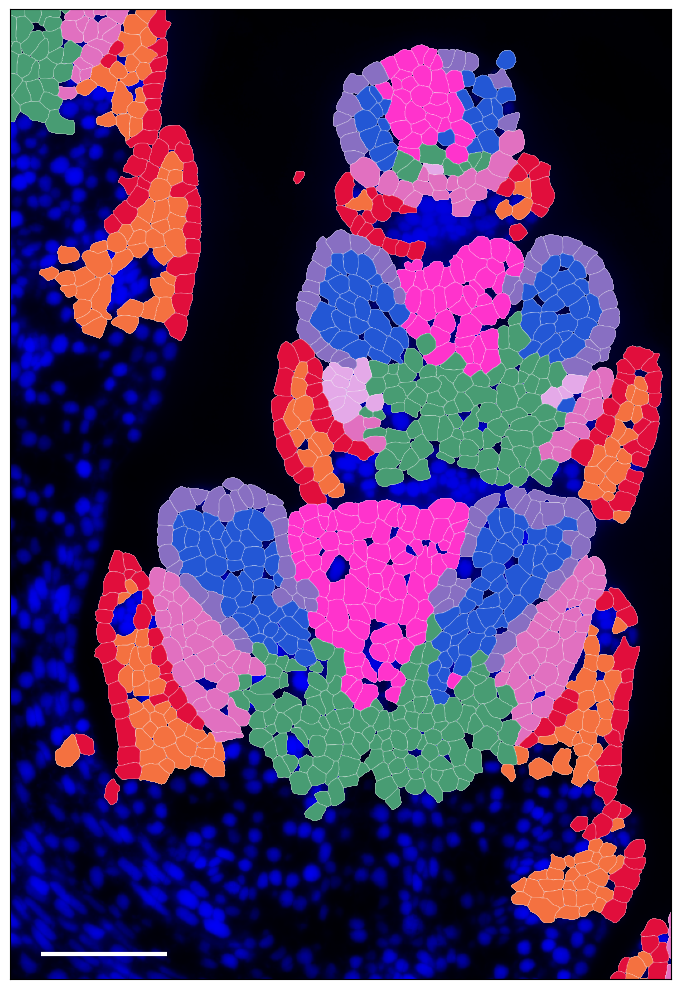

In [50]:
rotate_image_and_plot_clusters(
    segmentation_df=merged_segmentation_df,
    custom_cluster_colors={
        '1': '#e10e3c',
        '2': '#f47140',
        '7': '#489c73',
        '10': '#2357d5',
        '14': '#886fc2',
        '15': '#e170c0',
        '16': '#ff33cc',
        '17': '#e4a9e8'
    },
    rgb_img=rgb_img,
    angle=160,
    scale_bar_length=100,
    scale_bar_x_start=4325,
    scale_bar_y_start=4520,
    edge_color='white',
    default_edge_color='#FF000000',
    save_figure=True,
    save_path='leidenclustering/figures/VGN1c2_spikelet_ABCDE_100umscale.png',
    dpi=500,
    show_axis_ticks=False, 
    linewidth=0.1,
    xlim=(4450, 3925),
    ylim=(4500, 5270),
)


Processing TraesCS3A02G406500 (PI-2)...


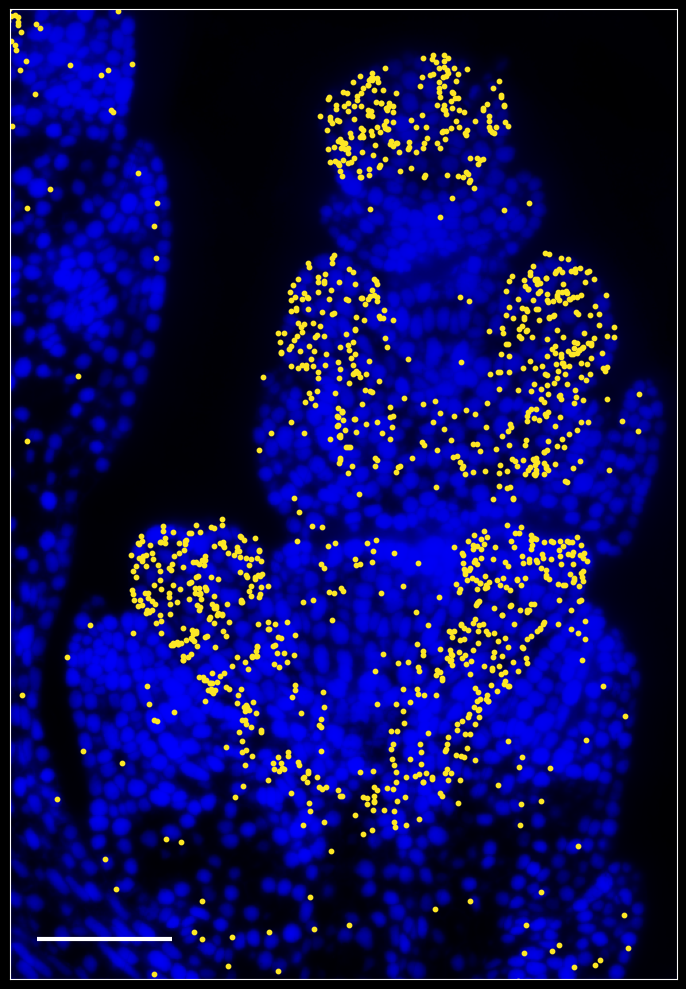

Processing TraesCS1A02G264300 (PI-1)...


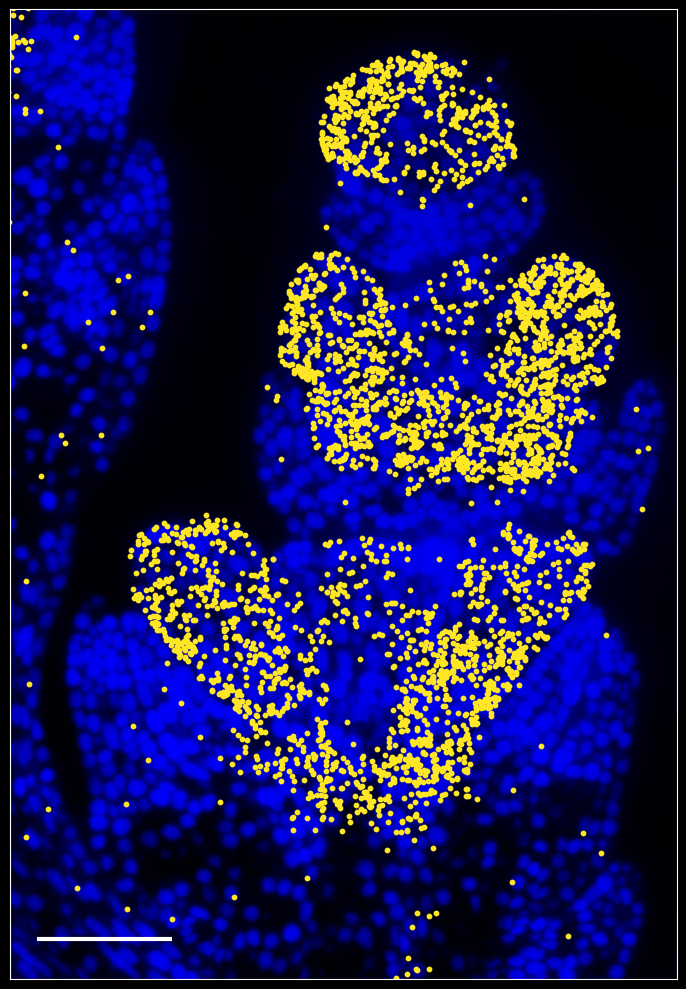

Processing TraesCS1D02G127700 (AG1)...


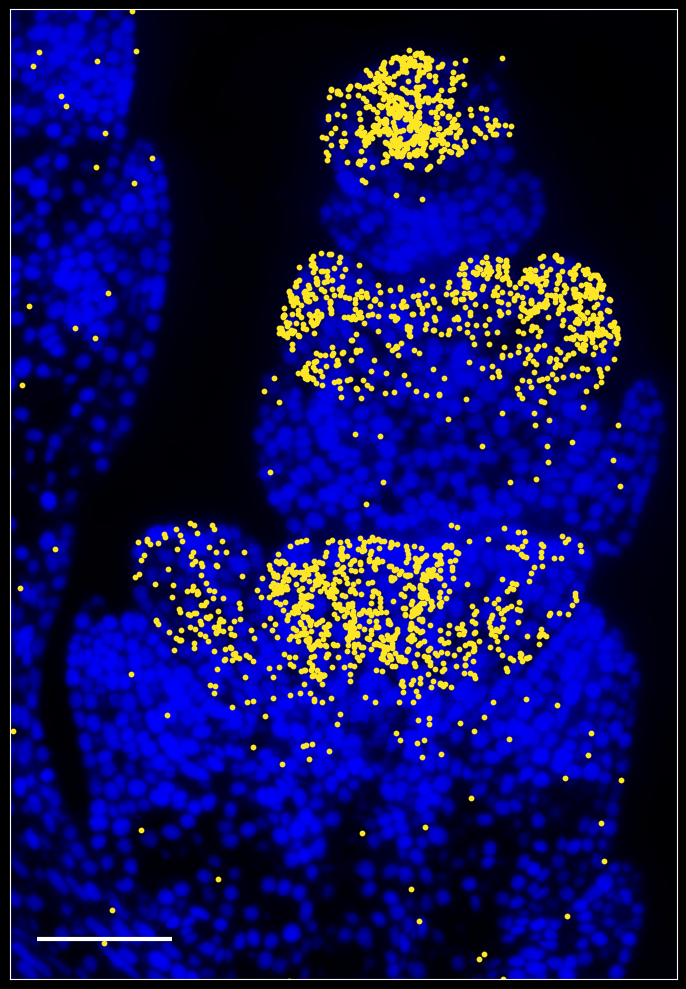

Processing TraesCS3A02G314300 (AG2)...


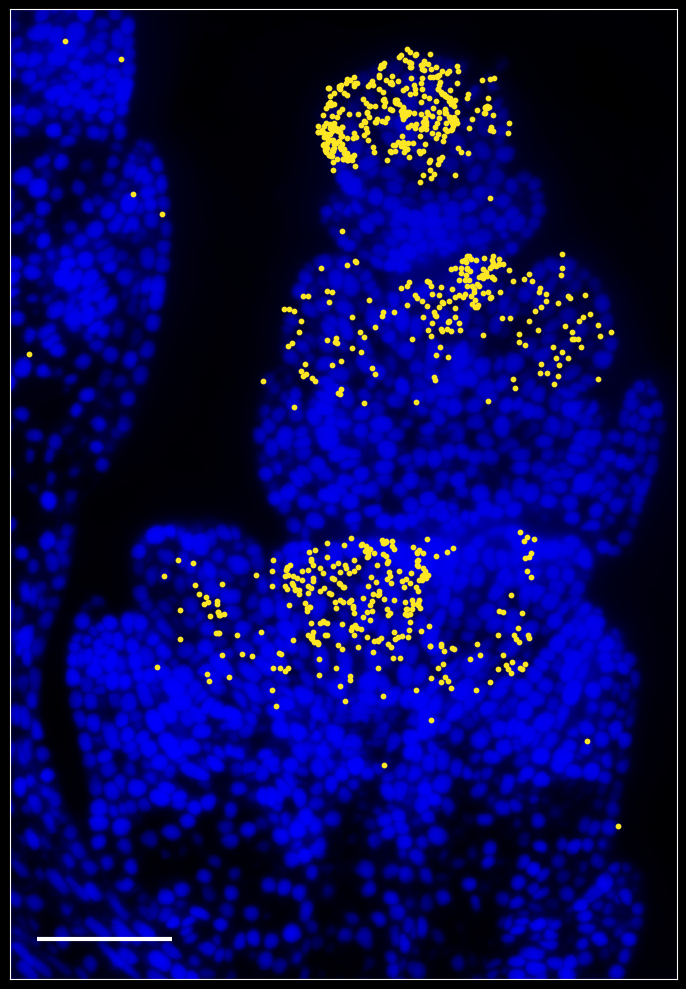

Processing TraesCS5D02G118200 (STK1)...


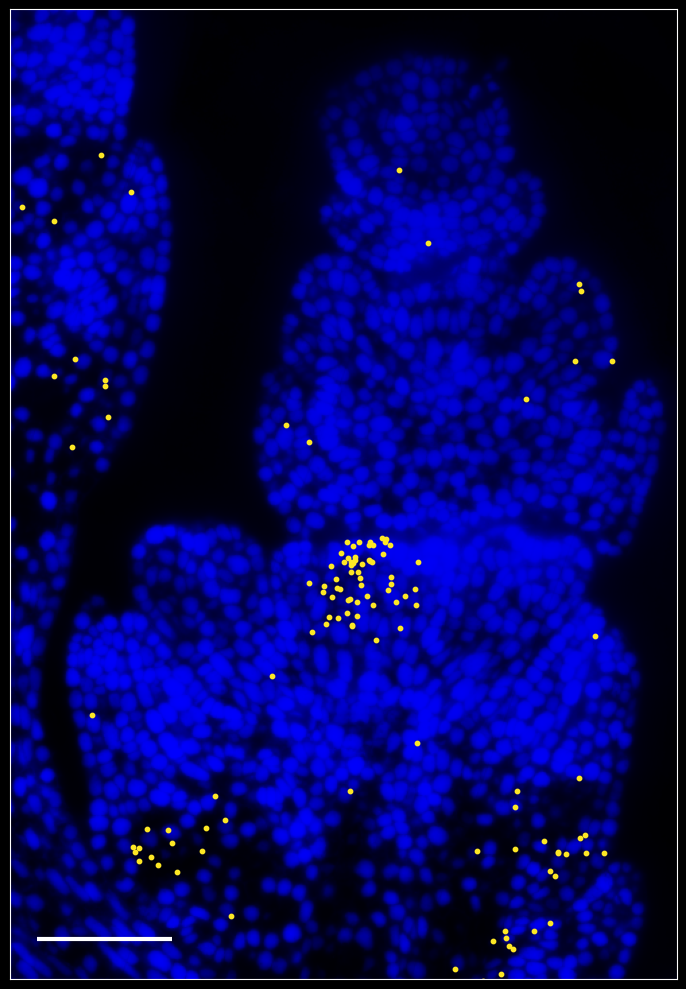

Processing TraesCS7D02G261600 (SEP3-1)...


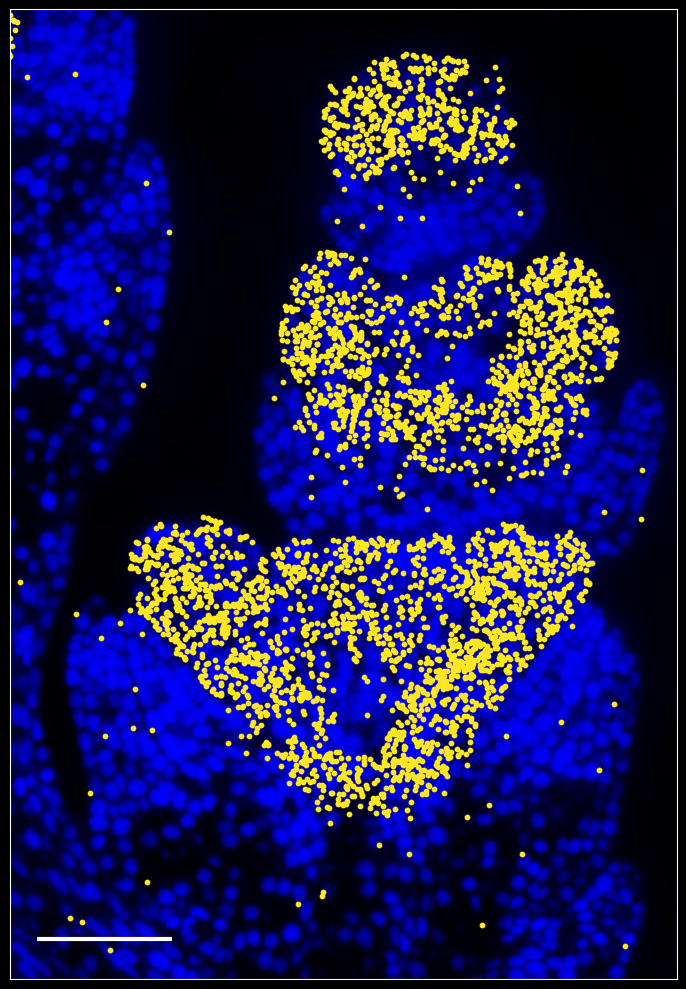

Processing TraesCS5A02G286800 (SEP3-2)...


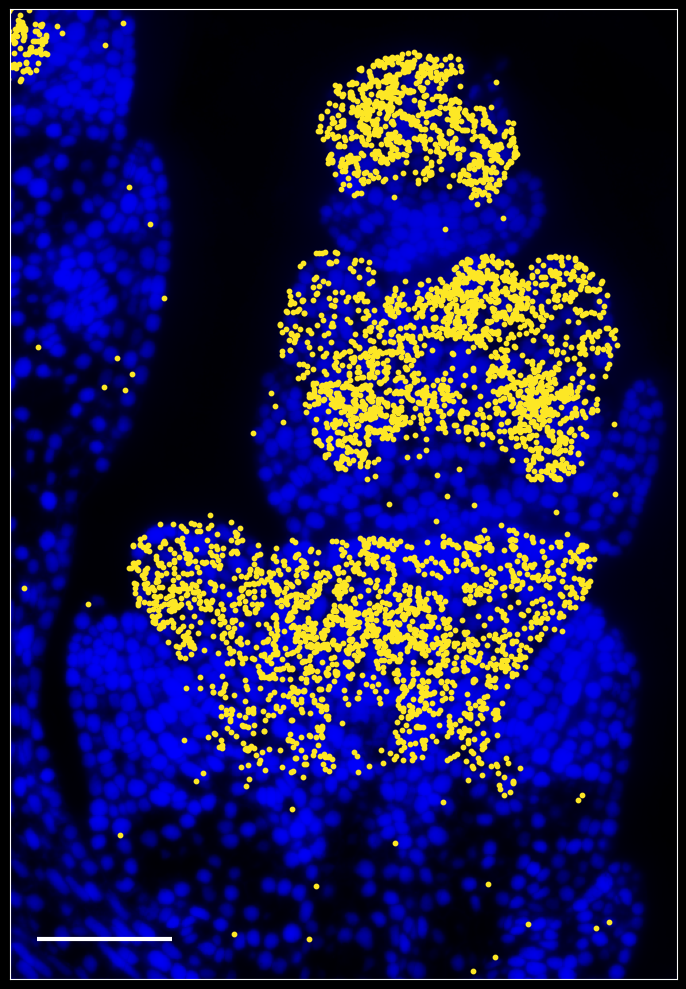

Processing TraesCS6A02G259000 (AGL6)...


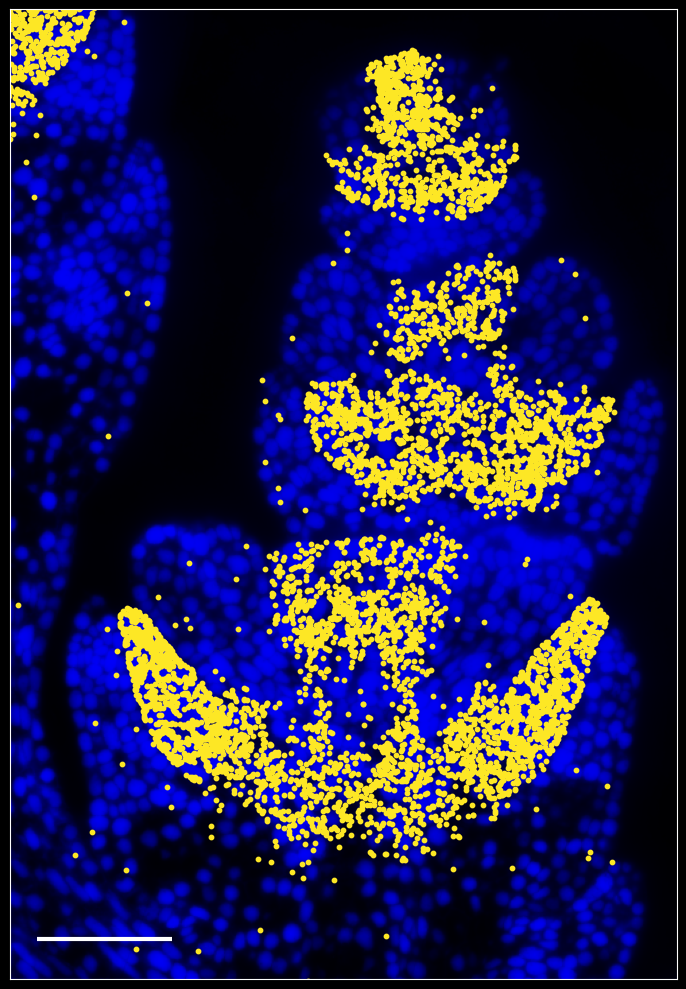

Processing TraesCS2B02G281000 (FUL2)...


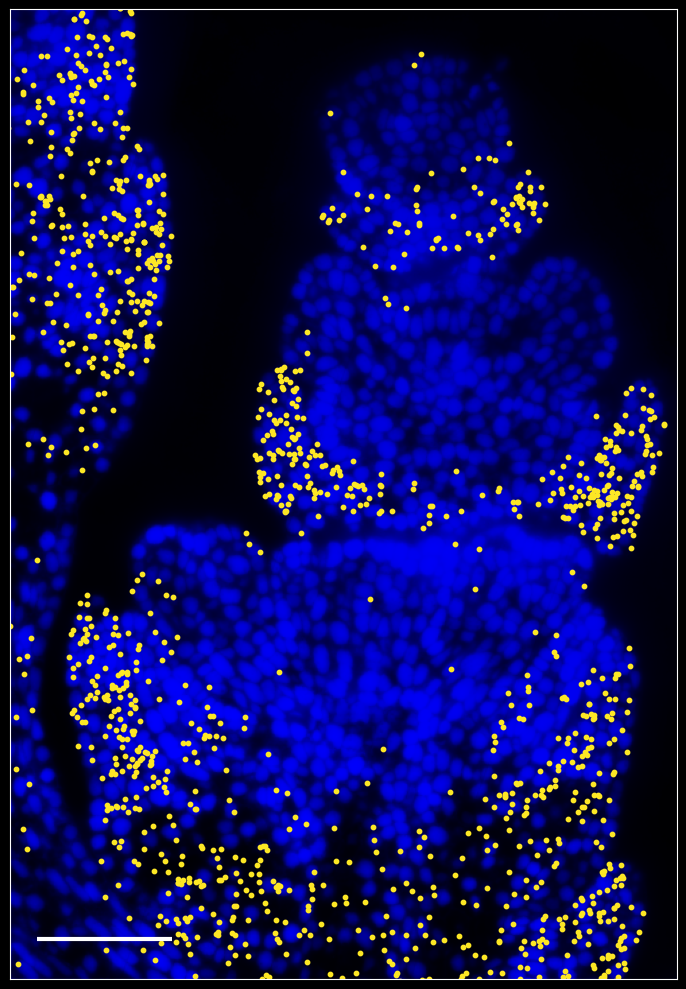

Processing TraesCS2A02G174300 (FUL3)...


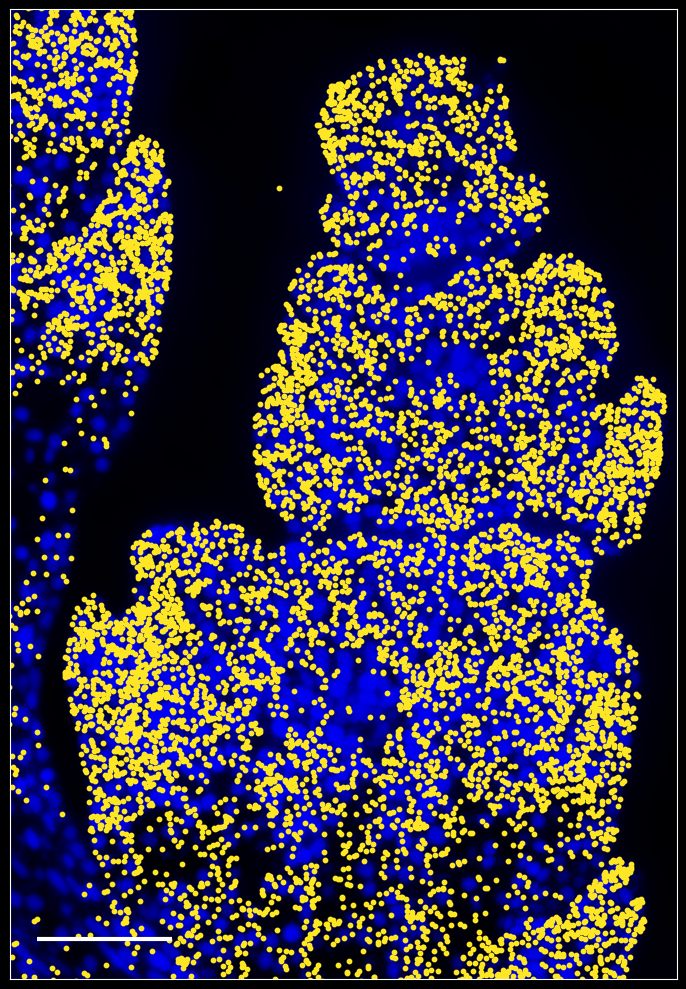

Processing TraesCS2D02G515800 (AP2L2)...


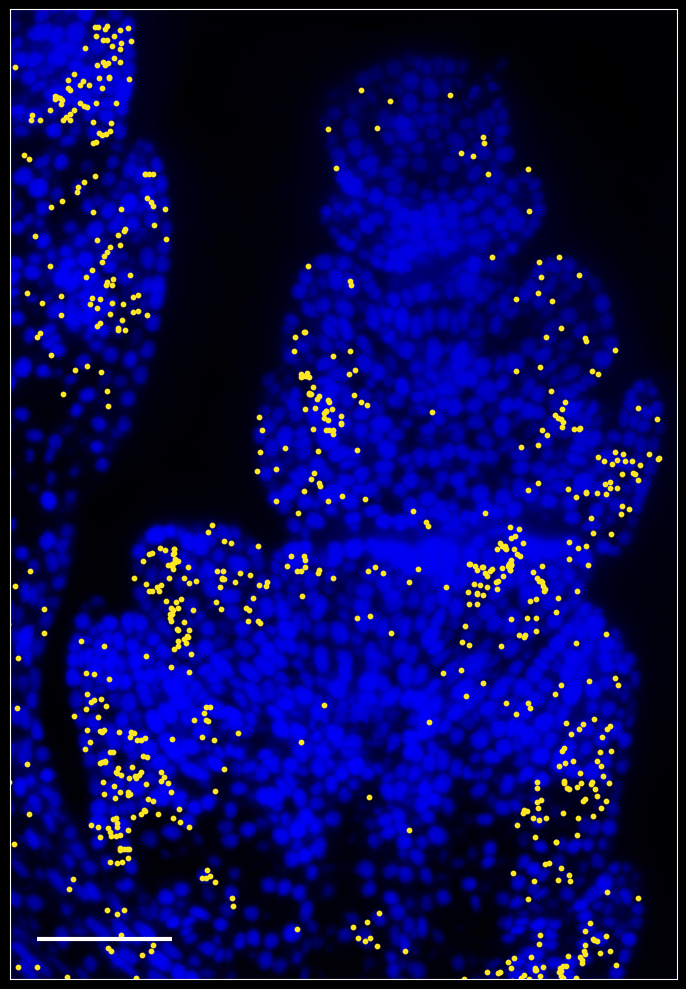

Processing TraesCS5A02G473800 (AP2L2)...


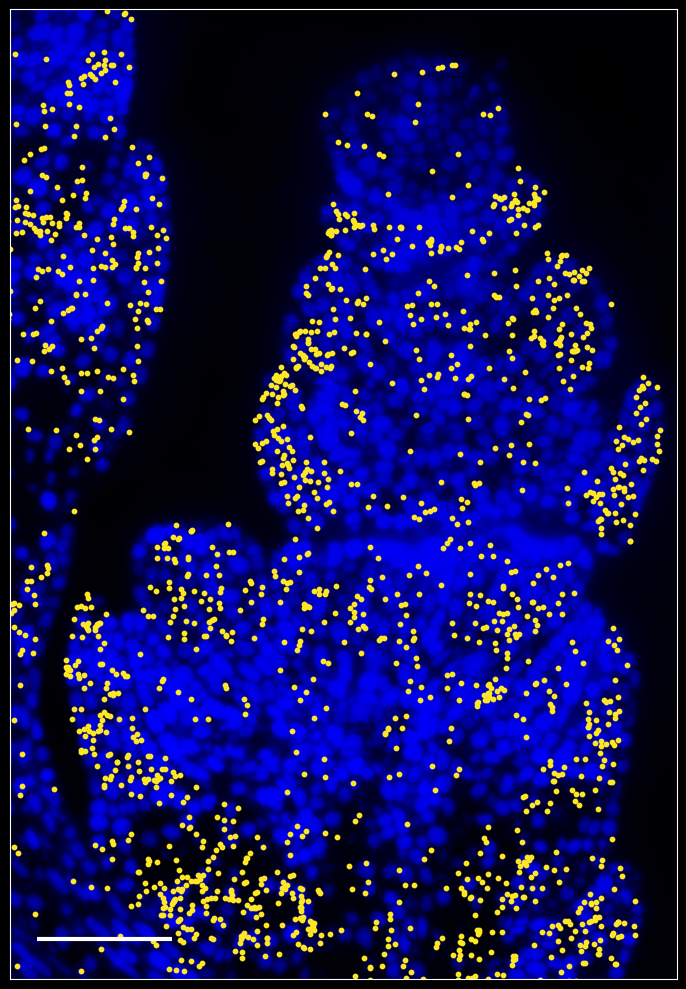

Processing TraesCS4B02G245800 (SEP1-1)...


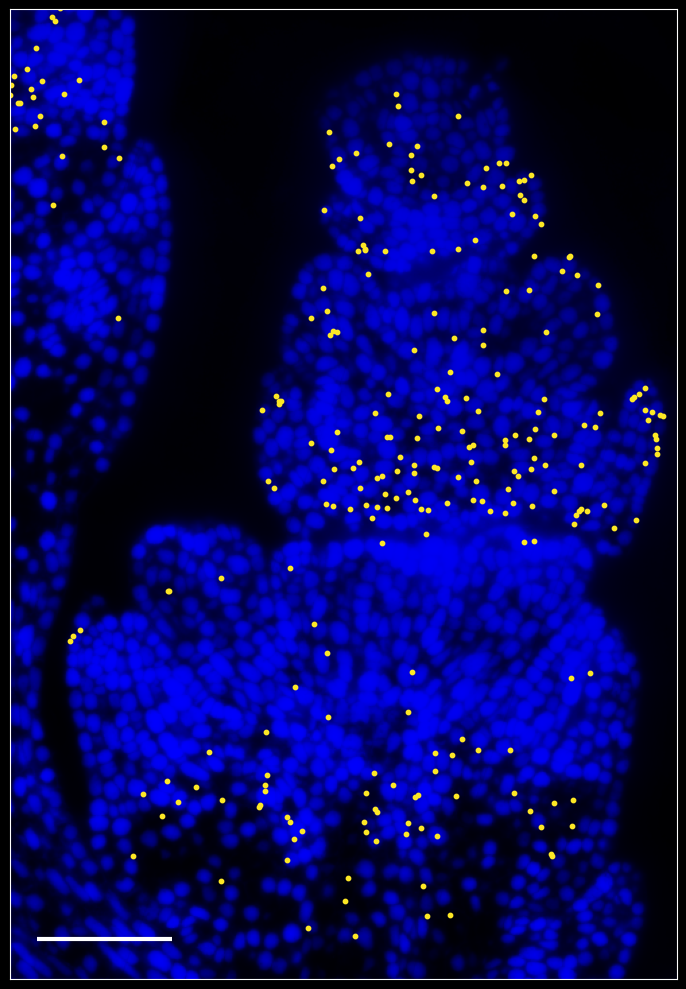

Processing TraesCS4D02G243700 (SEP1-2)...


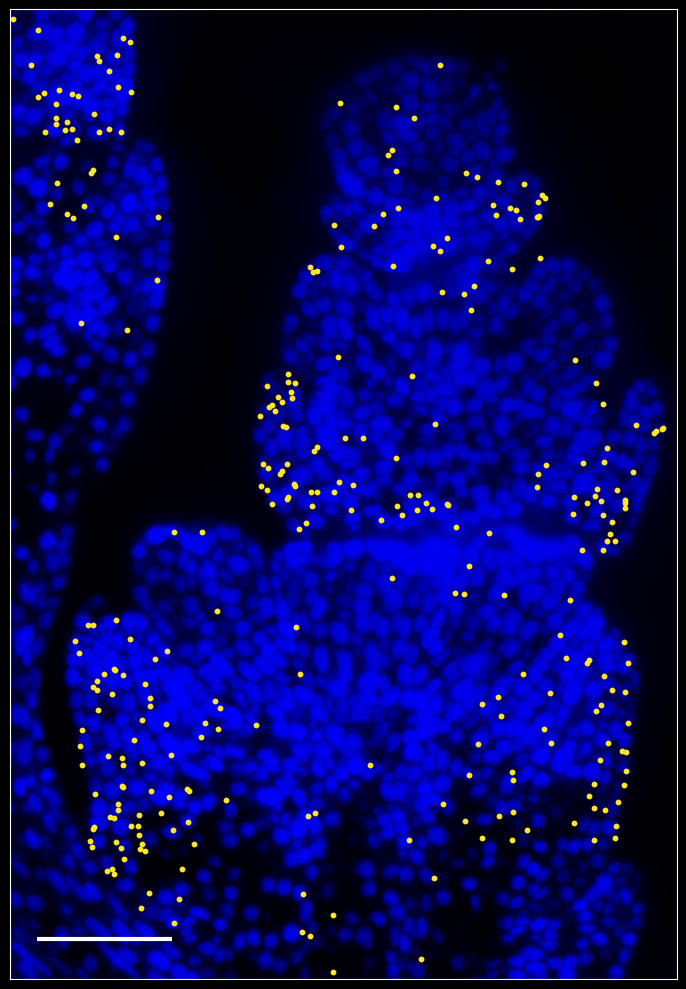

Processing TraesCS7D02G120500 (SEP1-4)...


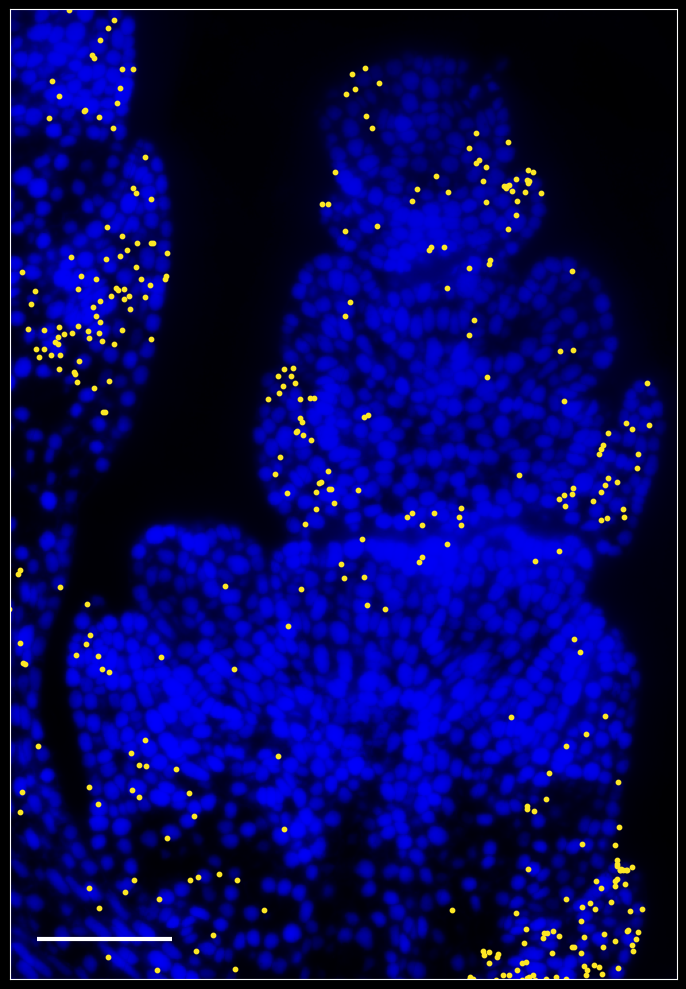

Processing TraesCS7D02G120600 (SEP1-5)...


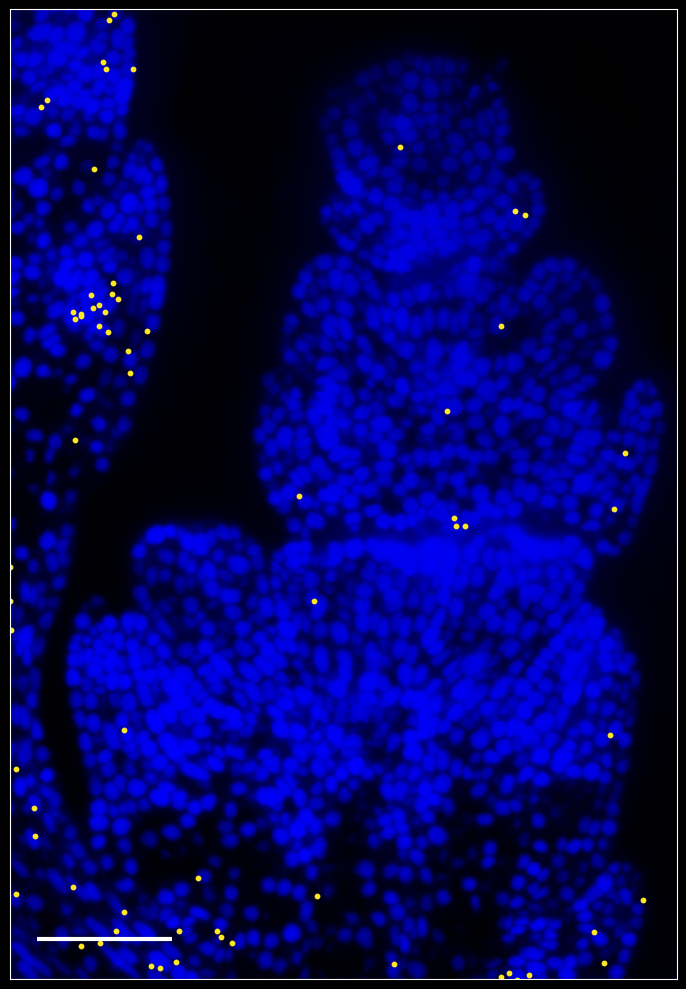

Processing TraesCS5B02G396700 (SEP1-6)...


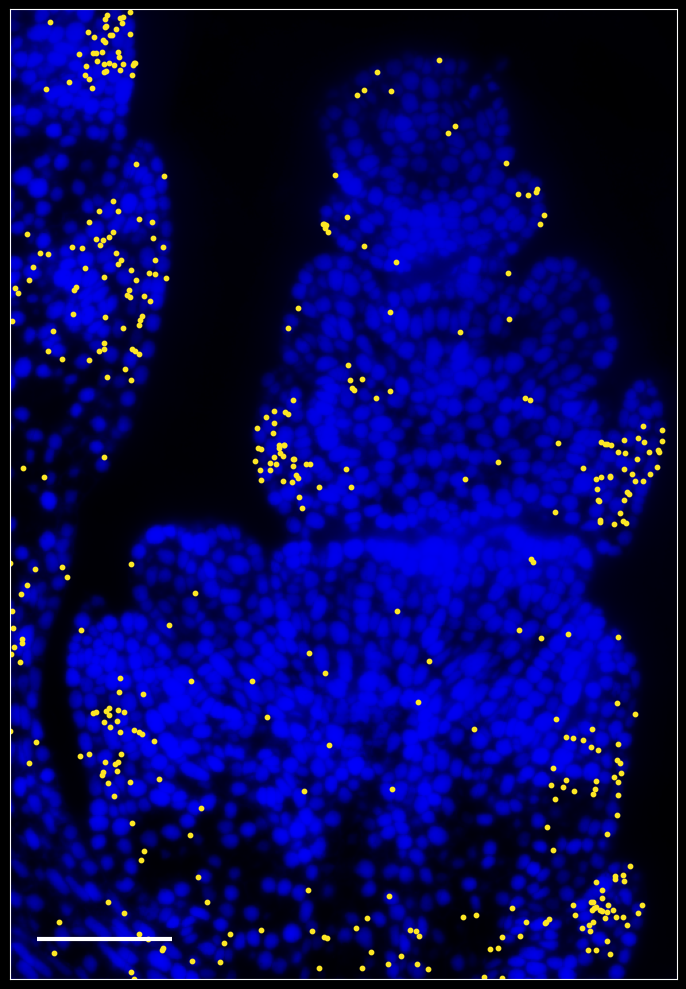

In [40]:
## loop through a list of genes 
# Example input

genes_to_plot = [
    ('TraesCS3A02G406500', 'PI-2'),
    ('TraesCS1A02G264300', 'PI-1'),
    ('TraesCS1D02G127700', 'AG1'),
    ('TraesCS3A02G314300', 'AG2'),
    ('TraesCS5D02G118200', 'STK1'),
    ('TraesCS7D02G261600', 'SEP3-1'),
    ('TraesCS5A02G286800', 'SEP3-2'),
    ('TraesCS6A02G259000', 'AGL6'),    
    ('TraesCS2B02G281000', 'FUL2'),
    ('TraesCS2A02G174300', 'FUL3'),
    ('TraesCS2D02G515800', 'AP2L2'),
    ('TraesCS5A02G473800', 'AP2L2'),
    ('TraesCS4B02G245800', 'SEP1-1'),
    ('TraesCS4D02G243700', 'SEP1-2'),    
    ('TraesCS7D02G120500', 'SEP1-4'),
    ('TraesCS7D02G120600', 'SEP1-5'),
    ('TraesCS5B02G396700', 'SEP1-6')
]

# Loop through each gene and generate plots
for gene_id, display_name in genes_to_plot:
    print(f"Processing {gene_id} ({display_name})...")

    rotate_image_and_transcripts_only(
        warped_img=warped_img,
        segmentation_df=merged_segmentation_df,
        transcripts_df=filtered_transcripts_df,
        genes_of_interest={gene_id: '#FDE725FF'},
        angle=160,
        scale_bar_length=100,
        scale_bar_x_start=4300,
        scale_bar_y_start=4580,
        rgb_img = rgb_img,
        edge_color='white',
        face_color='none',
        save_figure = True,
        save_path=f'enrichmentanalysis/figures/ABCDE_genes/VGN1c2_{display_name}_transcripts_stain_100umscalebar.png',
        dpi=500,
        show_axis_ticks=False,
        linewidth=0.1,
        pointsize=10,
        xlim=(4420, 3925),
        ylim=(4550, 5270),
    )
